In [ ]:
import os
import sys

"""Linux"""
os.chdir("/home/optimusprime/Desktop/peeterson/github/DeepAR_demand_prediction/Rental_Fleet_Demand_Forecast")
sys.path.append(os.path.abspath(os.path.join("/home/optimusprime/Desktop/peeterson/github/DeepAR_demand_prediction/Rental_Fleet_Demand_Forecast")))

os.chdir("/home/optimusprime/Desktop/peeterson/github/DeepAR_demand_prediction/Rental_Fleet_Demand_Forecast/libs/linux-gpu")


#from ctypes import FormatError
import numpy as np

import warnings
warnings.filterwarnings("ignore")

import os,sys

import torch
torch.use_deterministic_algorithms(True)
import pytorch_lightning as pl
from pytorch_forecasting.data.encoders import TorchNormalizer
from pytorch_forecasting.metrics import SMAPE, RMSE
from torchmetrics import R2Score, SymmetricMeanAbsolutePercentageError, MeanSquaredError

import matplotlib.pyplot as plt
import pandas as pd
from pytorch_forecasting.data import TimeSeriesDataSet
from pytorch_forecasting.data.encoders import NaNLabelEncoder
from pytorch_lightning.callbacks import EarlyStopping, LearningRateMonitor
import torch
from pytorch_forecasting.data.encoders import TorchNormalizer
import os,sys
import numpy as np
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf
from statsmodels.tsa.stattools import acf,pacf
from scipy.signal import find_peaks
import operator
import statsmodels.api as sm
from itertools import combinations
import pickle
from pytorch_forecasting import Baseline
import random
from pytorch_forecasting import DeepAR,NegativeBinomialDistributionLoss
from itertools import product
from sklearn.metrics import mean_absolute_error, mean_squared_error
import optuna
from optuna.trial import TrialState
import plotly
#from deepar_RegionWise_LinuxGpu_prediction_dev import train_and_forecast
from sklearn.metrics import classification_report

"""
Set Random seed
"""

random.seed(0)
torch.manual_seed(0)
np.random.seed(0)
## additional seeding to ensure reproduciblility.
pl.seed_everything(0)

2024-04-04 10:36:51.834553: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-04-04 10:36:51.835818: I external/local_tsl/tsl/cuda/cudart_stub.cc:31] Could not find cuda drivers on your machine, GPU will not be used.
2024-04-04 10:36:51.854166: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-04 10:36:51.854186: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-04 10:36:51.854811: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to

0

In [ ]:
standardised_num_ep = 30
reduced_dataset_size = 0.9

# Experiment 6

In [ ]:
### Best hyperparams

neu = 210
lay = 1
bat = 32
lr = 0.045984777597412985
drop = 0.0

num_ep = standardised_num_ep
dataset_size =reduced_dataset_size

In [ ]:
### Your code
os.chdir('/home/optimusprime/Desktop/Data_Timothy')
############ Basically df = raw_feat_df <-------------------------
df = pd.read_parquet('EXP_6_combined_dd_ss_raw_feat_data_poi_aggregation.parquet', engine='pyarrow')
df

,time_idx,datetime,group,target,inflow_lag_0,inflow_lag_1,inflow_lag_2,inflow_lag_3,inflow_lag_4,inflow_lag_5,...,"inflow_diff2_per1__fft_coefficient__attr_""real""__coeff_1",inflow_diff2_per1__count_above_mean,inflow_diff2_per1__count_below_mean,inflow_diff2_per1__autocorrelation__lag_1,inflow_diff2_per1__autocorrelation__lag_3,inflow_diff2_per1__partial_autocorrelation__lag_1,inflow_diff2_per1__skewness,inflow_diff2_per1__autocorrelation__lag_2,inflow_diff2_per1__kurtosis,inflow_diff2_per1__partial_autocorrelation__lag_2
0,169,2021-01-08 01:00:00,school,66.0,101.0,87.0,422.0,448.0,305.0,90.0,...,-60.456708,0.0,0.0,-0.081640,-0.027738,-0.081622,-0.496245,-0.263488,0.490017,-0.303142
1,170,2021-01-08 02:00:00,school,32.0,50.0,53.0,410.0,327.0,652.0,37.0,...,-14.000000,1.0,1.0,-1.000000,-0.027738,-0.081622,-0.496245,-0.263488,0.490017,-0.303142
2,171,2021-01-08 03:00:00,school,19.0,30.0,33.0,285.0,177.0,1094.0,24.0,...,-2.500000,1.0,2.0,-0.849256,-0.027738,-0.081622,0.633716,0.198511,0.490017,-0.303142
3,172,2021-01-08 04:00:00,school,25.0,19.0,25.0,143.0,101.0,1120.0,20.0,...,9.000000,2.0,2.0,-0.929158,-0.711447,-0.929158,-0.071375,0.749460,-2.711060,-0.303142
4,173,2021-01-08 05:00:00,school,105.0,30.0,32.0,69.0,50.0,1135.0,18.0,...,1.225425,3.0,2.0,-0.268487,-0.207884,-0.268487,-0.544485,-0.049543,-1.927011,-0.303142
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
246435,24808,2023-10-31 16:00:00,religious,732.0,998.0,848.0,906.0,1070.0,678.0,1169.0,...,-2348.787241,13.0,12.0,0.160769,-0.059342,0.160769,-0.004889,-0.165414,-1.039837,-0.196335
246436,24809,2023-10-31 17:00:00,religious,637.0,840.0,798.0,910.0,882.0,476.0,942.0,...,-1053.705532,14.0,11.0,0.129439,-0.185665,0.129439,-0.071656,-0.180286,-0.891656,-0.200398
246437,24810,2023-10-31 18:00:00,religious,602.0,697.0,737.0,951.0,879.0,297.0,895.0,...,-159.359368,15.0,10.0,0.142760,-0.226929,0.142760,-0.186733,-0.239184,-0.900303,-0.264965
246438,24811,2023-10-31 19:00:00,religious,452.0,665.0,678.0,998.0,942.0,124.0,933.0,...,-141.605817,14.0,11.0,0.139179,-0.186107,0.139179,-0.059585,-0.234582,-1.027312,-0.258970


In [ ]:
working_directory = '/home/optimusprime/Desktop/Training_Prediction_4_5_6'
os.chdir(working_directory)

In [ ]:
first_idx = df.loc[df['group'] == 'school', 'time_idx'].iloc[0]
total_time_idx = df[df.group == 'school'].shape[0]
reduced_df_time_idx = [*range(int((1-dataset_size)*total_time_idx), total_time_idx+1, 1)]
df = df[df['time_idx'].isin(reduced_df_time_idx)]

In [ ]:
numeric_cols = list(df.columns)
numeric_cols = [e for e in numeric_cols if e not in ('time_idx', 'datetime', 'group', 'target')]
print(numeric_cols)

['inflow_lag_0', 'inflow_lag_1', 'inflow_lag_2', 'inflow_lag_3', 'inflow_lag_4', 'inflow_lag_5', 'outflow_lag_0', 'outflow_lag_1', 'outflow_lag_2', 'outflow_lag_3', 'outflow_lag_4', 'outflow_lag_5', 'inflow', 'inflow_diff1_per1', 'inflow_diff1_per2', 'inflow_diff2_per1', 'inflow_lag_0__fft_coefficient__attr_"real"__coeff_1', 'inflow_lag_0__skewness', 'inflow_lag_0__kurtosis', 'inflow_lag_0__count_above_mean', 'inflow_lag_0__count_below_mean', 'inflow_lag_0__autocorrelation__lag_1', 'inflow_lag_0__autocorrelation__lag_2', 'inflow_lag_0__autocorrelation__lag_3', 'inflow_lag_0__partial_autocorrelation__lag_1', 'inflow_lag_0__partial_autocorrelation__lag_2', 'inflow_lag_0__partial_autocorrelation__lag_3', 'inflow_lag_0__fft_coefficient__attr_"real"__coeff_0', 'inflow_lag_1__fft_coefficient__attr_"real"__coeff_1', 'inflow_lag_1__skewness', 'inflow_lag_1__kurtosis', 'inflow_lag_1__count_above_mean', 'inflow_lag_1__count_below_mean', 'inflow_lag_1__autocorrelation__lag_1', 'inflow_lag_1__auto

In [ ]:
#################### add date information ts ####################

# create datetime features from datetime column in raw_feat_df
df['_hour_of_day'] = df["datetime"].dt.hour.astype(str)
df['_day_of_week'] = df["datetime"].dt.dayofweek.astype(str)
df['_day_of_month'] = df["datetime"].dt.day.astype(str)
df['_day_of_year'] = df["datetime"].dt.dayofyear.astype(str)
df['_week_of_year'] = df["datetime"].dt.weekofyear.astype(str)
df['_month_of_year'] = df["datetime"].dt.month.astype(str)
df['_year'] = df["datetime"].dt.year.astype(str)
#################### add date information ts ####################

hour_of_day_nunique = df['_hour_of_day'].nunique()
day_of_week_nunique = df['_day_of_week'].nunique()
day_of_month_nunique = df['_day_of_month'].nunique()
day_of_year_nunique = df['_day_of_year'].nunique()
week_of_year_nunique = df['_week_of_year'].nunique()
month_of_year_nunique = df['_month_of_year'].nunique()
year_nunique = df['_year'].nunique()

In [ ]:
df

,time_idx,datetime,group,target,inflow_lag_0,inflow_lag_1,inflow_lag_2,inflow_lag_3,inflow_lag_4,inflow_lag_5,...,inflow_diff2_per1__autocorrelation__lag_2,inflow_diff2_per1__kurtosis,inflow_diff2_per1__partial_autocorrelation__lag_2,_hour_of_day,_day_of_week,_day_of_month,_day_of_year,_week_of_year,_month_of_year,_year
2295,2464,2021-04-13 16:00:00,school,1927.0,1988.0,2050.0,1825.0,1771.0,490.0,2001.0,...,-0.105560,1.013099,-0.165698,16,1,13,103,15,4,2021
2296,2465,2021-04-13 17:00:00,school,1968.0,2061.0,2195.0,1909.0,2073.0,313.0,2060.0,...,-0.109107,1.017013,-0.168269,17,1,13,103,15,4,2021
2297,2466,2021-04-13 18:00:00,school,1654.0,2007.0,1897.0,1932.0,2069.0,147.0,1997.0,...,-0.082354,3.896016,-0.083866,18,1,13,103,15,4,2021
2298,2467,2021-04-13 19:00:00,school,1288.0,1586.0,1422.0,1498.0,1988.0,46.0,1723.0,...,-0.018635,5.679729,-0.037163,19,1,13,103,15,4,2021
2299,2468,2021-04-13 20:00:00,school,977.0,1252.0,943.0,1085.0,2061.0,46.0,1288.0,...,-0.025986,5.739378,-0.042606,20,1,13,103,15,4,2021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
246267,24640,2023-10-24 16:00:00,religious,699.0,1070.0,902.0,799.0,1048.0,647.0,1097.0,...,-0.346793,0.422282,-0.346987,16,1,24,297,43,10,2023
246268,24641,2023-10-24 17:00:00,religious,711.0,882.0,686.0,734.0,993.0,441.0,856.0,...,-0.367110,0.749651,-0.383293,17,1,24,297,43,10,2023
246269,24642,2023-10-24 18:00:00,religious,697.0,879.0,710.0,906.0,852.0,259.0,970.0,...,-0.373344,0.757791,-0.387397,18,1,24,297,43,10,2023
246270,24643,2023-10-24 19:00:00,religious,740.0,942.0,647.0,1070.0,932.0,117.0,870.0,...,-0.408777,0.120504,-0.420055,19,1,24,297,43,10,2023


In [ ]:
print(hour_of_day_nunique)
print(day_of_week_nunique)
print(day_of_month_nunique)
print(day_of_year_nunique)
print(week_of_year_nunique)
print(month_of_year_nunique)
print(year_nunique)

24
7
31
365
52
12
3


In [ ]:
unique_values_group_no_ts_fresh = list(df['group'].unique())
print(len(unique_values_group_no_ts_fresh), "\n")
print(unique_values_group_no_ts_fresh)

10 

['school', 'school_uni', 'school_sec', 'school_pri', 'food', 'food_restaurant', 'food_morning', 'food_bar', 'attractions', 'religious']


In [ ]:
encoder_len = 8 # looks back 8 hours in the past for prediction
pred_len = 1 # 1, 6, 12 # how many timeseteps you want to predict in the future (forecasting), 1 means present (nowcasting)
#cov_lag_len= pred_len

# not using covariates yet, so put as 0
cov_lag_len= 0 #we can use forecasted values, even for inflow

####### train val test split of tsfresh dataframe #########

### you want a the idx for each train, validation and test

### train = 0.7 of each zone (eg. time idx 167 to roughly 20000) eg train = 0.7 * (24812-167)
### validation = 0.2 of each zone (eg. time idx 20000 to 22000)
### test = 0.1 of each zone (eg. time idx 22000 to 24000)

Target = 'target'

total_time_idx = df[df.group == 'school'].shape[0]

first_idx = df.loc[df['group'] == 'school', 'time_idx'].iloc[0]

tr_stop_idx = int(0.7*total_time_idx)
val_start_idx = tr_stop_idx - encoder_len
# val_stop_idx = total_time_idx-1
val_stop_idx = val_start_idx + int(0.2*total_time_idx) # use (tr_stop_idx - encoder_len) as encoder from train set for validatoin
tes_start_idx = val_stop_idx - encoder_len
tes_stop_idx = total_time_idx-1
# tes_start_idx = tr_stop_idx - encoder_len
# tes_stop_idx = total_time_idx-1

print(tr_stop_idx)
print(val_start_idx)
print(val_stop_idx)
print(tes_start_idx)
print(tes_stop_idx)

15526
15518
19954
19946
22180


In [ ]:
train_time_idx = [*range(first_idx, first_idx+tr_stop_idx+1, 1)]
print(train_time_idx[0], train_time_idx[-1])
val_time_idx = [*range(first_idx+val_start_idx, first_idx+val_stop_idx+1, 1)]
print(val_time_idx[0], val_time_idx[-1])
test_time_idx = [*range(first_idx+tes_start_idx, first_idx+tes_stop_idx+1, 1)]
print(test_time_idx[0], test_time_idx[-1])

2464 17990
17982 22418
22410 24644


In [ ]:
"""
set inputs here
(hyperparameters grid search)

"""
######### Network Architecture ###################
# p = 10 # patience no. of epochs

Loss=NegativeBinomialDistributionLoss() # because we assume that the demand follows a negative bionmial distribution

######### Network Architecture ###################


######### Training Routine ###################
fdv_steps = 10 # fast_dev_run -> small set of training to see if training is happening correctly (one of the params in deepar model)
######### Training Routine ###################


# this is for naive forecast, getting past week's demand and predicting purely based on that
############## Inputs for 2) Persistance model ( seasonal naive forecast ) #######################
season_len = 168 # length of season ()
num_past_seas = 6 # number of past seasons to use in averaging (look at 6 week's back, getting average of these 6 values)
#seas_pred_strt_idx = 2035 # seasonal naive forecast start index, in hours use the df dataframe
############## Inputs for 2) Persistance model ( seasonal naive forecast ) #######################


In [ ]:
lr_logger = LearningRateMonitor()

cat_dict = {"_hour_of_day": NaNLabelEncoder(add_nan=True).fit(df._hour_of_day),
          "_day_of_week": NaNLabelEncoder(add_nan=True).fit(df._day_of_week), "_day_of_month" : NaNLabelEncoder(add_nan=True).fit(df._day_of_month), "_day_of_year" : NaNLabelEncoder(add_nan=True).fit(df._day_of_year),
              "_week_of_year": NaNLabelEncoder(add_nan=True).fit(df._week_of_year), "_month_of_year": NaNLabelEncoder(add_nan=True).fit(df._month_of_year) ,"_year": NaNLabelEncoder(add_nan=True).fit(df._year)}
cat_list = ["_hour_of_day","_day_of_week","_day_of_month","_day_of_year","_week_of_year","_month_of_year","_year"]
embed_size_dict = {'_hour_of_day':(hour_of_day_nunique+1,5),'_day_of_week':(day_of_week_nunique+1,5),'_day_of_month':(day_of_month_nunique+1,5), '_day_of_year':(day_of_year_nunique+1,8), '_week_of_year':(week_of_year_nunique+1,3), '_month_of_year':(month_of_year_nunique+1,3),'_year':(year_nunique+1,1)}

train_dataset = TimeSeriesDataSet(
  df[(df['time_idx'].isin(train_time_idx))],
  time_idx="time_idx",
  target=Target,
  categorical_encoders=cat_dict,
  group_ids=["group"],
  min_encoder_length=encoder_len,
  max_encoder_length=encoder_len,
  min_prediction_length=pred_len,
  max_prediction_length=pred_len,
  time_varying_unknown_reals=[Target],
  time_varying_known_reals=numeric_cols,
  time_varying_known_categoricals=cat_list,
  add_relative_time_idx=False,
  randomize_length=False,
  scalers={},
  target_normalizer=TorchNormalizer(method="identity",center=False,transformation=None)
)

val_dataset = TimeSeriesDataSet.from_dataset(train_dataset,df[(df['time_idx'].isin(val_time_idx))], stop_randomization=True, predict=False)
# test_dataset = TimeSeriesDataSet.from_dataset(train_dataset,df[df['time_idx'].isin(test_time_idx)], stop_randomization=True)

train_dataloader = train_dataset.to_dataloader(train=True, batch_size=bat)
val_dataloader = val_dataset.to_dataloader(train=False, batch_size=bat)
# test_dataloader = test_dataset.to_dataloader(train=False, batch_size=bat)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..
`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..
Missing logger folder: /home/optimusprime/Desktop/Training_Prediction_4_5_6/lightning_logs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name                   | Type                             | Params
----------------------------------------------------------------------------
0 | loss                   | NegativeBinomialDistributionLoss | 0     
1 | logging_metrics        | ModuleList                       | 0     
2 | embeddings             | MultiEmbedding                   | 3.5 K 
3 | rnn                    | LSTM                             | 375 K 
4 | distribution_projector | Linear                           | 422   
---------------------------

Epoch 29: 100%|██████████| 6234/6234 [02:32<00:00, 40.87it/s, loss=7.69, v_num=0, train_loss_step=7.470, val_loss=7.870, train_loss_epoch=7.760]

`Trainer.fit` stopped: `max_epochs=30` reached.


Epoch 29: 100%|██████████| 6234/6234 [02:32<00:00, 40.86it/s, loss=7.69, v_num=0, train_loss_step=7.470, val_loss=7.870, train_loss_epoch=7.760]


Predict: 100%|██████████| 70/70 [00:02<00:00, 33.18 batches/s]


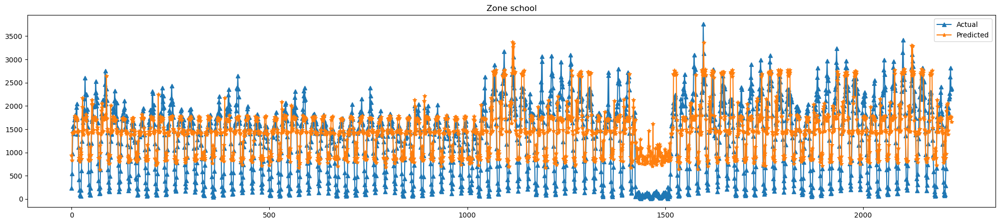

Average RMSE for 2224 days:  397.36825539568343
full average RMSE =  495.8892369690298
Average WMAPE for 2224 days:  22.568708922630382
full average WMAPE =  22.568708922630385 



Predict: 100%|██████████| 70/70 [00:01<00:00, 35.39 batches/s]


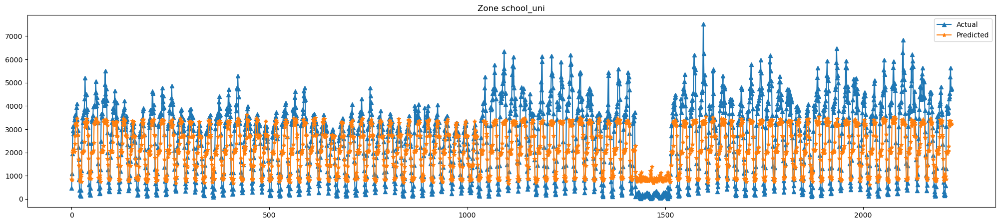

Average RMSE for 2224 days:  818.7297661870504
full average RMSE =  1030.1341929504192
Average WMAPE for 2224 days:  21.74744294500916
full average WMAPE =  21.74744294500916 



Predict: 100%|██████████| 70/70 [00:02<00:00, 33.43 batches/s]


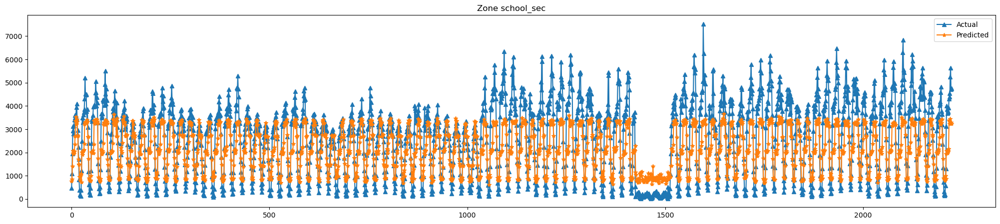

Average RMSE for 2224 days:  820.3493705035971
full average RMSE =  1031.9409784496384
Average WMAPE for 2224 days:  21.8365364600095
full average WMAPE =  21.8365364600095 



Predict: 100%|██████████| 70/70 [00:02<00:00, 33.77 batches/s]


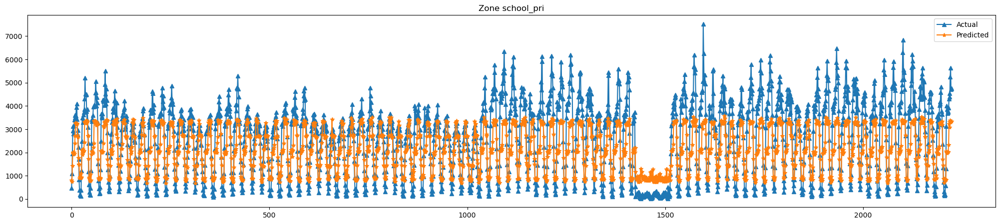

Average RMSE for 2224 days:  820.6515287769785
full average RMSE =  1031.7183780473813
Average WMAPE for 2224 days:  21.835058511609713
full average WMAPE =  21.835058511609713 



Predict: 100%|██████████| 70/70 [00:01<00:00, 35.49 batches/s]


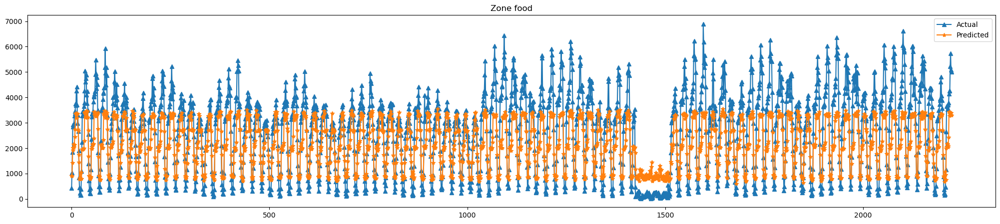

Average RMSE for 2224 days:  810.0247302158274
full average RMSE =  1009.1237595757459
Average WMAPE for 2224 days:  20.920521369447894
full average WMAPE =  20.920521369447894 



Predict: 100%|██████████| 70/70 [00:01<00:00, 35.16 batches/s]


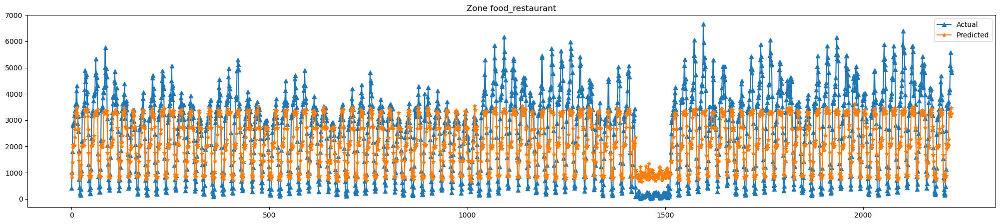

Average RMSE for 2224 days:  755.169964028777
full average RMSE =  934.9976488832825
Average WMAPE for 2224 days:  20.74105692446485
full average WMAPE =  20.741056924464846 



Predict: 100%|██████████| 70/70 [00:02<00:00, 34.43 batches/s]


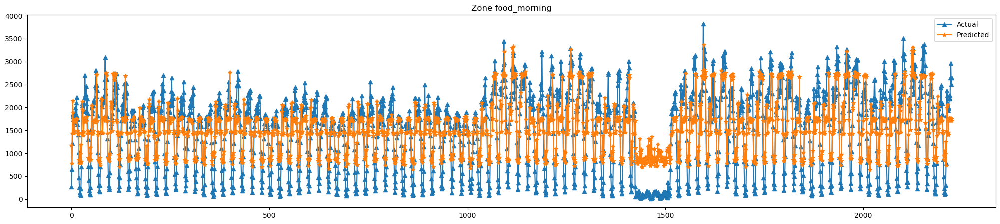

Average RMSE for 2224 days:  406.2571942446043
full average RMSE =  499.72058649643935
Average WMAPE for 2224 days:  20.67235366491844
full average WMAPE =  20.672353664918436 



Predict: 100%|██████████| 70/70 [00:01<00:00, 35.10 batches/s]


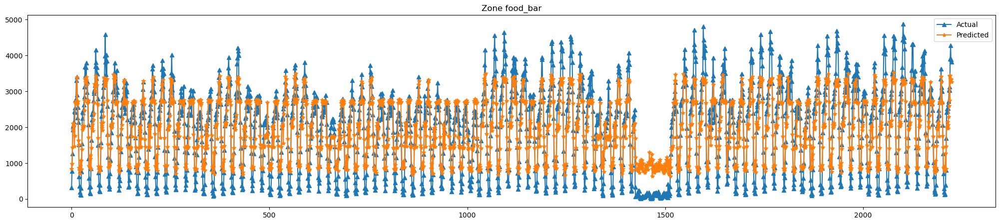

Average RMSE for 2224 days:  435.5031474820144
full average RMSE =  523.1561432973756
Average WMAPE for 2224 days:  18.268170777942256
full average WMAPE =  18.268170777942256 



Predict: 100%|██████████| 70/70 [00:02<00:00, 30.82 batches/s]


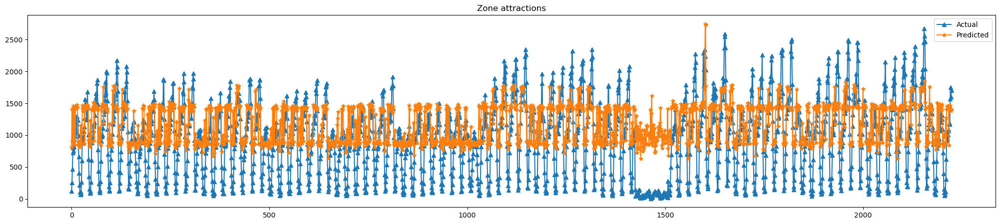

Average RMSE for 2224 days:  408.9226618705036
full average RMSE =  505.9115544235776
Average WMAPE for 2224 days:  26.651210971997557
full average WMAPE =  26.651210971997553 



Predict: 100%|██████████| 70/70 [00:02<00:00, 25.33 batches/s]


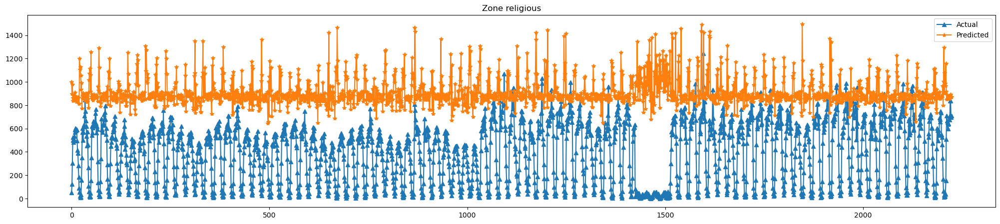

Average RMSE for 2224 days:  521.5678956834532
full average RMSE =  614.6724631545094
Average WMAPE for 2224 days:  44.947004498310086
full average WMAPE =  44.947004498310086 



'\nMachine Learning predictions END\n'

In [ ]:
"""
Machine Learning predictions START
1) DeepAR

"""
trainer = pl.Trainer(
    max_epochs=num_ep,
    accelerator='gpu',
    devices=[0],
    auto_lr_find=False,
    gradient_clip_val=0.1,
    limit_train_batches=1.0,
    limit_val_batches=1.0,
    #fast_dev_run=fdv_steps,
    logger=True,
    #log_every_n_steps=10,
    # profiler=True,
    callbacks=[lr_logger]#, early_stop_callback],
    #enable_checkpointing=True,
    #default_root_dir="C:\Work\WORK_PACKAGE\Demand_forecasting\github\DeepAR-pytorch\My_model\2_freq_nbinom_LSTM\1_cluster_demand_prediction\logs"
)

#print(f"training routing:\n \n {trainer}")
deepar =DeepAR.from_dataset(
    train_dataset,
    learning_rate=lr,
    hidden_size=neu,
    rnn_layers=lay,
    dropout=drop,
    loss=Loss,
    log_interval=20,
    log_val_interval=6,
    log_gradient_flow=False,
    embedding_sizes=embed_size_dict
    # reduce_on_plateau_patience=3,
)

#print(f"Number of parameters in network: {deepar.size()/1e3:.1f}k")
# print(f"Model :\n \n {deepar}")
torch.set_num_threads(10)
trainer.fit(
    deepar,
    train_dataloaders=train_dataloader,
    val_dataloaders=val_dataloader,
)

########## Prediction #####################

for group in unique_values_group_no_ts_fresh:
  test_dataset = TimeSeriesDataSet.from_dataset(train_dataset,df[df['time_idx'].isin(test_time_idx) & (df['group'] == group)], stop_randomization=True)
  test_dataloader = test_dataset.to_dataloader(train=False, batch_size=bat)


  test_output = deepar.predict(data=test_dataloader,mode='prediction',return_index=True,num_workers=8,show_progress_bar=True)

  pred_start_idx = int(test_output[1]['time_idx'][0])

  actual1_full = np.array([])
  pred_full = np.array([])
  RMSE_list = np.array([])
  WMAPE_list = np.array([])
  days = tes_stop_idx - val_stop_idx - pred_len - pred_len

  for j in range(0,days,pred_len):

    # if j == 0:
    #   print('pred_start_idx = ',df["datetime"].iloc[pred_start_idx],pred_start_idx )

    actual_df = df[df['group'] == group]

    prediction_index = [*range(pred_start_idx+(j), pred_start_idx+(j)+pred_len, 1)]

    actual = actual_df[actual_df['time_idx'].isin(prediction_index)]['target'].values

    actual1_full = np.append(actual1_full, actual)
    #plt.plot(actual,'*-')
    pred = np.array(np.rint(test_output[0][j])).astype(int)

    pred_full = np.append(pred_full, pred)
    #plt.plot(pred,'^-')
    #plt.show()

    absolute_error = np.abs(actual - pred)
    absolute_sum = np.abs(actual) + np.abs(pred)
    WMAPE = np.mean(absolute_error / (absolute_sum + 1e-8)) * 100

    # WMAPE = np.mean(np.abs(actual-pred)/np.abs(actual)+ 1e-8) * 100
    RMSE = np.sqrt(mean_squared_error(actual,pred ))
    #print('RMSE : ',RMSE)
    RMSE_list = np.append(RMSE_list,RMSE)
    WMAPE_list = np.append(WMAPE_list,WMAPE)

  plt.figure(figsize=(25,5))
  plt.plot(actual1_full.flatten(),'^-', label='Actual')
  plt.plot(pred_full.flatten(),'*-', label='Predicted')
  plt.title('Zone ' + str(group))  # Replace 'XYZ' with your actual group number
  plt.legend()
  plt.show()

  print(f'Average RMSE for {days} days: ',np.mean(RMSE_list))
  print('full average RMSE = ',np.sqrt(mean_squared_error(actual1_full.flatten(),pred_full.flatten() )))
  print(f'Average WMAPE for {days} days: ',np.mean(WMAPE_list))
  wmape_full = np.mean(np.abs(actual1_full.flatten() - pred_full.flatten()) / (np.abs(actual1_full.flatten()) + np.abs(pred_full.flatten()) + 1e-8)) * 100
  print('full average WMAPE = ', wmape_full, '\n')

########## Prediction #####################



"""
Machine Learning predictions END
"""

# Experiment 5

In [ ]:
### Best hyperparams

neu = 210
lay = 3
bat = 32
lr = 0.01644130325721595
drop = 0.6

num_ep = standardised_num_ep
dataset_size = reduced_dataset_size

In [ ]:
### Your code
os.chdir('/home/optimusprime/Desktop/Data_Timothy')
############ Basically df = raw_feat_df <-------------------------
df = pd.read_parquet('EXP_5_combined_dd_ss_raw_feat_data_cluster_aggregation.parquet', engine='pyarrow')
df

,time_idx,datetime,group,target,inflow_lag_0,inflow_lag_1,inflow_lag_2,inflow_lag_3,outflow_lag_0,outflow_lag_1,...,"inflow_diff2_per1__fft_coefficient__attr_""real""__coeff_0","inflow_diff2_per1__fft_coefficient__attr_""real""__coeff_1",inflow_diff2_per1__kurtosis,inflow_diff2_per1__autocorrelation__lag_2,inflow_diff2_per1__autocorrelation__lag_1,inflow_diff2_per1__partial_autocorrelation__lag_1,inflow_diff2_per1__partial_autocorrelation__lag_3,inflow_diff2_per1__autocorrelation__lag_3,inflow_diff2_per1__skewness,inflow_diff2_per1__count_above_mean
0,167,2021-01-07 23:00:00,50,59.0,107.0,38.0,12.0,117.0,122.0,41.0,...,-3.0,-4.786351,0.561537,-0.128245,-0.269178,-0.269166,-0.110965,-0.026810,-0.468564,0.0
1,168,2021-01-08 00:00:00,50,32.0,67.0,14.0,30.0,158.0,59.0,23.0,...,4.0,-10.000000,0.561537,-0.128245,-1.000000,-0.269166,-0.110965,-0.026810,-0.468564,1.0
2,169,2021-01-08 01:00:00,50,32.0,34.0,17.0,84.0,120.0,32.0,23.0,...,27.0,-18.000000,0.561537,-1.465116,-0.017442,-0.269166,-0.110965,-0.026810,0.670284,1.0
3,170,2021-01-08 02:00:00,50,24.0,24.0,4.0,162.0,63.0,32.0,8.0,...,25.0,-26.000000,0.891341,-0.741231,-0.406555,-0.406555,-0.110965,0.702128,1.279001,2.0
4,171,2021-01-08 03:00:00,50,9.0,12.0,12.0,243.0,24.0,24.0,27.0,...,31.0,-15.972136,1.663525,-0.630481,-0.373850,-0.373850,-0.110965,0.432843,1.254480,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
247120,24808,2023-10-31 16:00:00,246,937.0,833.0,866.0,701.0,161.0,1060.0,1083.0,...,18.0,-155.248275,0.388287,-0.356099,0.135241,0.135241,0.053212,-0.073461,-0.347820,12.0
247121,24809,2023-10-31 17:00:00,246,884.0,797.0,842.0,560.0,75.0,937.0,979.0,...,-7.0,-110.884152,0.401069,-0.358260,0.141407,0.141407,0.077524,-0.060138,-0.317217,12.0
247122,24810,2023-10-31 18:00:00,246,843.0,766.0,772.0,324.0,37.0,884.0,959.0,...,68.0,38.090968,0.503437,-0.384094,0.142216,0.142216,0.048863,-0.096132,-0.416259,13.0
247123,24811,2023-10-31 19:00:00,246,735.0,764.0,701.0,161.0,32.0,843.0,791.0,...,-20.0,24.437373,0.209153,-0.370867,0.126136,0.126136,0.053884,-0.069905,-0.314286,13.0


In [ ]:
working_directory = '/home/optimusprime/Desktop/Training_Prediction_4_5_6'
os.chdir(working_directory)

In [ ]:
first_idx = df.loc[df['group'] == 141, 'time_idx'].iloc[0]
total_time_idx = df[df.group == 141].shape[0]
reduced_df_time_idx = [*range(int((1-dataset_size)*total_time_idx), total_time_idx+1, 1)]
df = df[df['time_idx'].isin(reduced_df_time_idx)]

In [ ]:
numeric_cols = list(df.columns)
numeric_cols = [e for e in numeric_cols if e not in ('time_idx', 'datetime', 'group', 'target')]
print(numeric_cols)

['inflow_lag_0', 'inflow_lag_1', 'inflow_lag_2', 'inflow_lag_3', 'outflow_lag_0', 'outflow_lag_1', 'outflow_lag_2', 'outflow_lag_3', 'inflow', 'inflow_diff1_per1', 'inflow_diff1_per2', 'inflow_diff2_per1', 'inflow_lag_0__fft_coefficient__attr_"real"__coeff_0', 'inflow_lag_0__fft_coefficient__attr_"real"__coeff_1', 'inflow_lag_0__skewness', 'inflow_lag_0__count_above_mean', 'inflow_lag_0__autocorrelation__lag_1', 'inflow_lag_0__count_below_mean', 'inflow_lag_0__autocorrelation__lag_2', 'inflow_lag_0__autocorrelation__lag_3', 'inflow_lag_0__partial_autocorrelation__lag_2', 'inflow_lag_0__partial_autocorrelation__lag_1', 'inflow_lag_0__partial_autocorrelation__lag_3', 'inflow_lag_0__kurtosis', 'inflow_lag_1__fft_coefficient__attr_"real"__coeff_0', 'inflow_lag_1__fft_coefficient__attr_"real"__coeff_1', 'inflow_lag_1__skewness', 'inflow_lag_1__count_above_mean', 'inflow_lag_1__autocorrelation__lag_1', 'inflow_lag_1__count_below_mean', 'inflow_lag_1__autocorrelation__lag_2', 'inflow_lag_1__a

In [ ]:
#################### add date information ts ####################

# create datetime features from datetime column in raw_feat_df
df['_hour_of_day'] = df["datetime"].dt.hour.astype(str)
df['_day_of_week'] = df["datetime"].dt.dayofweek.astype(str)
df['_day_of_month'] = df["datetime"].dt.day.astype(str)
df['_day_of_year'] = df["datetime"].dt.dayofyear.astype(str)
df['_week_of_year'] = df["datetime"].dt.weekofyear.astype(str)
df['_month_of_year'] = df["datetime"].dt.month.astype(str)
df['_year'] = df["datetime"].dt.year.astype(str)
#################### add date information ts ####################

hour_of_day_nunique = df['_hour_of_day'].nunique()
day_of_week_nunique = df['_day_of_week'].nunique()
day_of_month_nunique = df['_day_of_month'].nunique()
day_of_year_nunique = df['_day_of_year'].nunique()
week_of_year_nunique = df['_week_of_year'].nunique()
month_of_year_nunique = df['_month_of_year'].nunique()
year_nunique = df['_year'].nunique()

In [ ]:
df

,time_idx,datetime,group,target,inflow_lag_0,inflow_lag_1,inflow_lag_2,inflow_lag_3,outflow_lag_0,outflow_lag_1,...,inflow_diff2_per1__autocorrelation__lag_3,inflow_diff2_per1__skewness,inflow_diff2_per1__count_above_mean,_hour_of_day,_day_of_week,_day_of_month,_day_of_year,_week_of_year,_month_of_year,_year
2311,2478,2021-04-14 06:00:00,50,411.0,120.0,322.0,406.0,321.0,272.0,505.0,...,-0.090886,-0.383398,15.0,6,2,14,104,15,4,2021
2312,2479,2021-04-14 07:00:00,50,501.0,225.0,346.0,460.0,341.0,411.0,518.0,...,-0.086888,-0.294891,14.0,7,2,14,104,15,4,2021
2313,2480,2021-04-14 08:00:00,50,474.0,314.0,347.0,527.0,371.0,501.0,482.0,...,-0.180060,-0.306350,14.0,8,2,14,104,15,4,2021
2314,2481,2021-04-14 09:00:00,50,492.0,338.0,370.0,518.0,434.0,474.0,460.0,...,-0.164683,-0.484318,15.0,9,2,14,104,15,4,2021
2315,2482,2021-04-14 10:00:00,50,463.0,398.0,406.0,545.0,457.0,492.0,459.0,...,-0.097465,-0.536210,15.0,10,2,14,104,15,4,2021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
247098,24786,2023-10-30 18:00:00,246,791.0,772.0,616.0,278.0,41.0,959.0,627.0,...,-0.339896,-0.911517,15.0,18,0,30,303,44,10,2023
247099,24787,2023-10-30 19:00:00,246,537.0,701.0,553.0,158.0,34.0,791.0,557.0,...,-0.339944,-0.846031,15.0,19,0,30,303,44,10,2023
247100,24788,2023-10-30 20:00:00,246,358.0,560.0,426.0,97.0,41.0,537.0,409.0,...,-0.296306,-0.805763,15.0,20,0,30,303,44,10,2023
247101,24789,2023-10-30 21:00:00,246,161.0,324.0,278.0,41.0,98.0,358.0,245.0,...,-0.289268,-0.880379,15.0,21,0,30,303,44,10,2023


In [ ]:
print(hour_of_day_nunique)
print(day_of_week_nunique)
print(day_of_month_nunique)
print(day_of_year_nunique)
print(week_of_year_nunique)
print(month_of_year_nunique)
print(year_nunique)

24
7
31
365
52
12
3


In [ ]:
unique_values_group_no_ts_fresh = list(df['group'].unique())
print(len(unique_values_group_no_ts_fresh), "\n")
print(unique_values_group_no_ts_fresh)

10 

[50, 74, 120, 125, 141, 151, 232, 238, 239, 246]


In [ ]:
encoder_len = 8 # looks back 8 hours in the past for prediction
pred_len = 1 # 1, 6, 12 # how many timeseteps you want to predict in the future (forecasting), 1 means present (nowcasting)
#cov_lag_len= pred_len

# not using covariates yet, so put as 0
cov_lag_len= 0 #we can use forecasted values, even for inflow

####### train val test split of tsfresh dataframe #########

### you want a the idx for each train, validation and test

### train = 0.7 of each zone (eg. time idx 167 to roughly 20000) eg train = 0.7 * (24812-167)
### validation = 0.2 of each zone (eg. time idx 20000 to 22000)
### test = 0.1 of each zone (eg. time idx 22000 to 24000)

Target = 'target'

total_time_idx = df[df.group == 141].shape[0]

first_idx = df.loc[df['group'] == 141, 'time_idx'].iloc[0]

tr_stop_idx = int(0.7*total_time_idx)
val_start_idx = tr_stop_idx - encoder_len
# val_stop_idx = total_time_idx-1
val_stop_idx = val_start_idx + int(0.2*total_time_idx) # use (tr_stop_idx - encoder_len) as encoder from train set for validatoin
tes_start_idx = val_stop_idx - encoder_len
tes_stop_idx = total_time_idx-1
# tes_start_idx = tr_stop_idx - encoder_len
# tes_stop_idx = total_time_idx-1

print(tr_stop_idx)
print(val_start_idx)
print(val_stop_idx)
print(tes_start_idx)
print(tes_stop_idx)

15619
15611
20073
20065
22312


In [ ]:
train_time_idx = [*range(first_idx, first_idx+tr_stop_idx+1, 1)]
print(train_time_idx[0], train_time_idx[-1])
val_time_idx = [*range(first_idx+val_start_idx, first_idx+val_stop_idx+1, 1)]
print(val_time_idx[0], val_time_idx[-1])
test_time_idx = [*range(first_idx+tes_start_idx, first_idx+tes_stop_idx+1, 1)]
print(test_time_idx[0], test_time_idx[-1])

2478 18097
18089 22551
22543 24790


In [ ]:
"""
set inputs here
(hyperparameters grid search)

"""
######### Network Architecture ###################
# p = 10 # patience no. of epochs

Loss=NegativeBinomialDistributionLoss() # because we assume that the demand follows a negative bionmial distribution

######### Network Architecture ###################


######### Training Routine ###################
fdv_steps = 10 # fast_dev_run -> small set of training to see if training is happening correctly (one of the params in deepar model)
######### Training Routine ###################


# this is for naive forecast, getting past week's demand and predicting purely based on that
############## Inputs for 2) Persistance model ( seasonal naive forecast ) #######################
season_len = 168 # length of season ()
num_past_seas = 6 # number of past seasons to use in averaging (look at 6 week's back, getting average of these 6 values)
#seas_pred_strt_idx = 2035 # seasonal naive forecast start index, in hours use the df dataframe
############## Inputs for 2) Persistance model ( seasonal naive forecast ) #######################


In [ ]:
lr_logger = LearningRateMonitor()

cat_dict = {"_hour_of_day": NaNLabelEncoder(add_nan=True).fit(df._hour_of_day),
          "_day_of_week": NaNLabelEncoder(add_nan=True).fit(df._day_of_week), "_day_of_month" : NaNLabelEncoder(add_nan=True).fit(df._day_of_month), "_day_of_year" : NaNLabelEncoder(add_nan=True).fit(df._day_of_year),
              "_week_of_year": NaNLabelEncoder(add_nan=True).fit(df._week_of_year), "_month_of_year": NaNLabelEncoder(add_nan=True).fit(df._month_of_year) ,"_year": NaNLabelEncoder(add_nan=True).fit(df._year)}
cat_list = ["_hour_of_day","_day_of_week","_day_of_month","_day_of_year","_week_of_year","_month_of_year","_year"]
embed_size_dict = {'_hour_of_day':(hour_of_day_nunique+1,5),'_day_of_week':(day_of_week_nunique+1,5),'_day_of_month':(day_of_month_nunique+1,5), '_day_of_year':(day_of_year_nunique+1,8), '_week_of_year':(week_of_year_nunique+1,3), '_month_of_year':(month_of_year_nunique+1,3),'_year':(year_nunique+1,1)}

train_dataset = TimeSeriesDataSet(
  df[(df['time_idx'].isin(train_time_idx))],
  time_idx="time_idx",
  target=Target,
  categorical_encoders=cat_dict,
  group_ids=["group"],
  min_encoder_length=encoder_len,
  max_encoder_length=encoder_len,
  min_prediction_length=pred_len,
  max_prediction_length=pred_len,
  time_varying_unknown_reals=[Target],
  time_varying_known_reals=numeric_cols,
  time_varying_known_categoricals=cat_list,
  add_relative_time_idx=False,
  randomize_length=False,
  scalers={},
  target_normalizer=TorchNormalizer(method="identity",center=False,transformation=None)
)

val_dataset = TimeSeriesDataSet.from_dataset(train_dataset,df[(df['time_idx'].isin(val_time_idx))], stop_randomization=True, predict=False)
# test_dataset = TimeSeriesDataSet.from_dataset(train_dataset,df[df['time_idx'].isin(test_time_idx)], stop_randomization=True)

train_dataloader = train_dataset.to_dataloader(train=True, batch_size=bat)
val_dataloader = val_dataset.to_dataloader(train=False, batch_size=bat)
# test_dataloader = test_dataset.to_dataloader(train=False, batch_size=bat)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..
`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name                   | Type                             | Params
----------------------------------------------------------------------------
0 | loss                   | NegativeBinomialDistributionLoss | 0     
1 | logging_metrics        | ModuleList                       | 0     
2 | embeddings             | MultiEmbedding                   | 3.5 K 
3 | rnn                    | LSTM                             | 1.0 M 
4 | distribution_projector | Linear                           | 422   
----------------------------------------------------------------------------
1.0 M     Trainable params
0         Non-

Epoch 0:  20%|██        | 1262/6271 [00:21<01:26, 58.09it/s, loss=7.05, v_num=1, train_loss_step=7.100]

Epoch 29: 100%|██████████| 6271/6271 [02:12<00:00, 47.42it/s, loss=5.35, v_num=1, train_loss_step=5.250, val_loss=5.280, train_loss_epoch=5.310]

`Trainer.fit` stopped: `max_epochs=30` reached.


Epoch 29: 100%|██████████| 6271/6271 [02:12<00:00, 47.41it/s, loss=5.35, v_num=1, train_loss_step=5.250, val_loss=5.280, train_loss_epoch=5.310]


Predict: 100%|██████████| 70/70 [00:07<00:00,  9.74 batches/s]


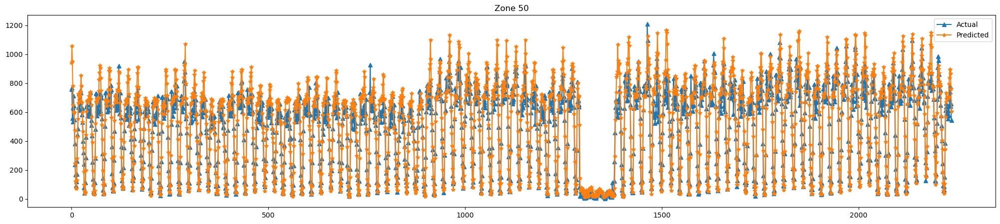

Average RMSE for 2237 days:  73.99329459097005
full average RMSE =  101.49062245416181
Average WMAPE for 2237 days:  9.373556518029122
full average WMAPE =  9.37355651802912 



Predict: 100%|██████████| 70/70 [00:12<00:00,  5.51 batches/s]


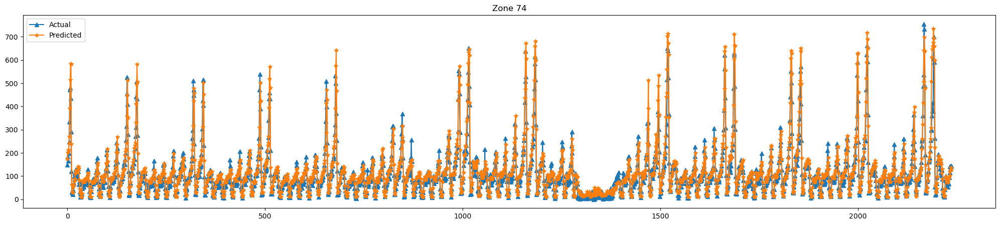

Average RMSE for 2237 days:  25.555654894948592
full average RMSE =  45.463195015618545
Average WMAPE for 2237 days:  13.593618878411759
full average WMAPE =  13.593618878411759 



Predict: 100%|██████████| 70/70 [00:12<00:00,  5.59 batches/s]


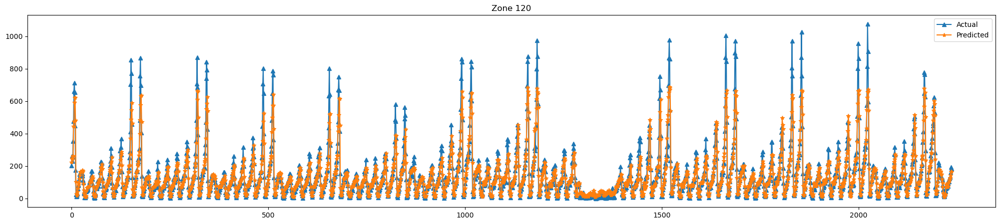

Average RMSE for 2237 days:  33.87483236477425
full average RMSE =  66.59161025982159
Average WMAPE for 2237 days:  14.229930988026428
full average WMAPE =  14.229930988026426 



Predict: 100%|██████████| 70/70 [00:13<00:00,  5.27 batches/s]


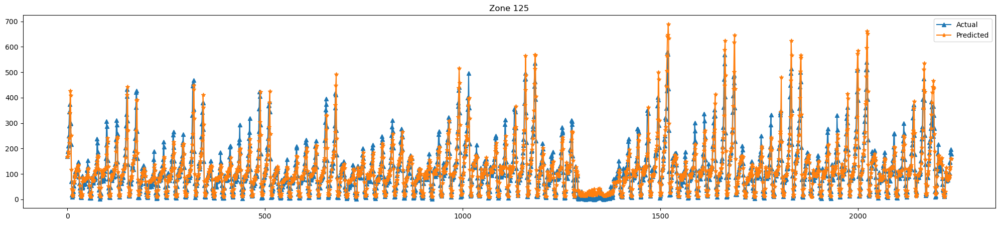

Average RMSE for 2237 days:  25.544926240500672
full average RMSE =  41.83676262806599
Average WMAPE for 2237 days:  14.26932641528523
full average WMAPE =  14.26932641528523 



Predict: 100%|██████████| 70/70 [00:07<00:00,  8.90 batches/s]


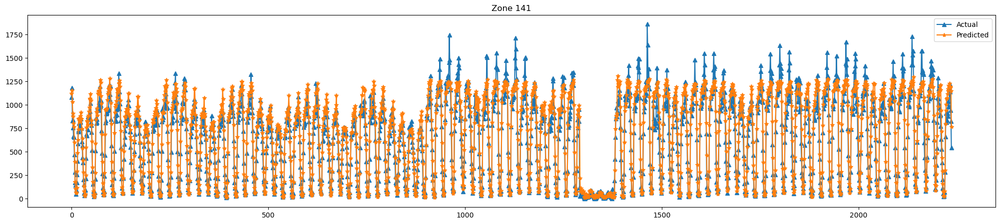

Average RMSE for 2237 days:  94.72507822977201
full average RMSE =  129.16603654895067
Average WMAPE for 2237 days:  9.402972723272702
full average WMAPE =  9.402972723272702 



Predict: 100%|██████████| 70/70 [00:09<00:00,  7.02 batches/s]


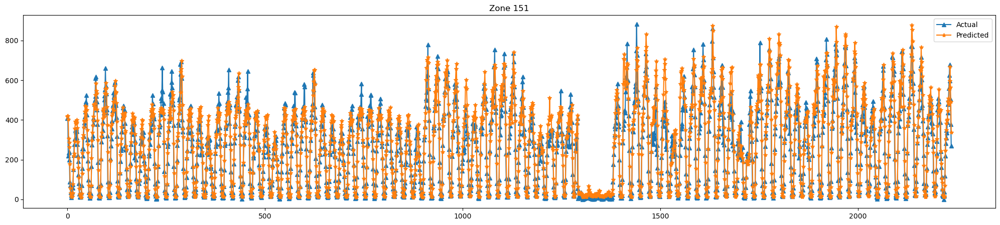

Average RMSE for 2237 days:  45.54447921323201
full average RMSE =  68.47043679752328
Average WMAPE for 2237 days:  14.034264040471363
full average WMAPE =  14.034264040471362 



Predict: 100%|██████████| 70/70 [00:13<00:00,  5.24 batches/s]


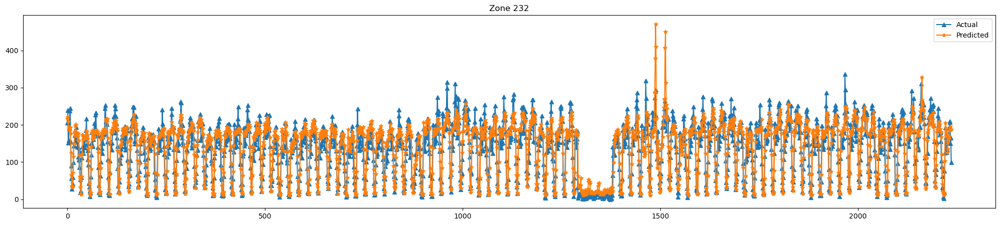

Average RMSE for 2237 days:  24.057666517657577
full average RMSE =  31.563610550001535
Average WMAPE for 2237 days:  12.749907606489481
full average WMAPE =  12.749907606489478 



Predict: 100%|██████████| 70/70 [00:07<00:00,  9.39 batches/s]


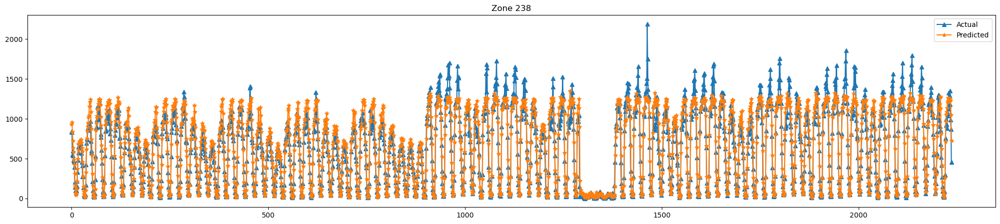

Average RMSE for 2237 days:  96.0585605721949
full average RMSE =  137.632970613551
Average WMAPE for 2237 days:  10.072097303880529
full average WMAPE =  10.07209730388053 



Predict: 100%|██████████| 70/70 [00:07<00:00,  8.77 batches/s]


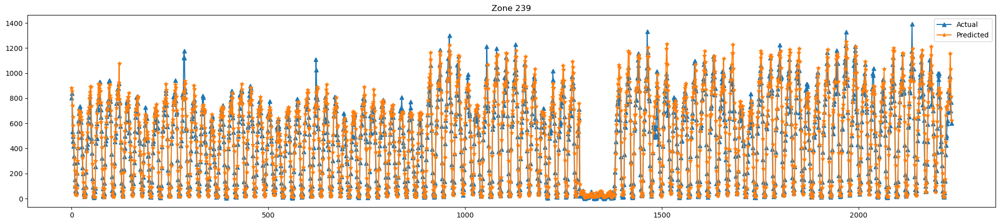

Average RMSE for 2237 days:  64.90567724631202
full average RMSE =  95.46294981647092
Average WMAPE for 2237 days:  11.085441602762529
full average WMAPE =  11.085441602762529 



Predict: 100%|██████████| 70/70 [00:07<00:00,  9.85 batches/s]


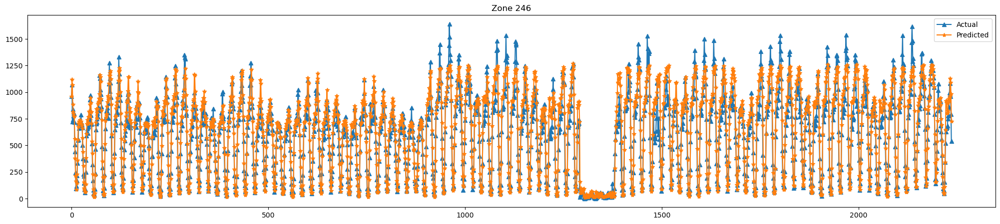

Average RMSE for 2237 days:  86.37058560572194
full average RMSE =  120.05994442279882
Average WMAPE for 2237 days:  9.477256027608103
full average WMAPE =  9.477256027608103 



'\nMachine Learning predictions END\n'

In [ ]:
"""
Machine Learning predictions START
1) DeepAR

"""
trainer = pl.Trainer(
    max_epochs=num_ep,
    accelerator='gpu',
    devices=[0],
    auto_lr_find=False,
    gradient_clip_val=0.1,
    limit_train_batches=1.0,
    limit_val_batches=1.0,
    #fast_dev_run=fdv_steps,
    logger=True,
    #log_every_n_steps=10,
    # profiler=True,
    callbacks=[lr_logger]#, early_stop_callback],
    #enable_checkpointing=True,
    #default_root_dir="C:\Work\WORK_PACKAGE\Demand_forecasting\github\DeepAR-pytorch\My_model\2_freq_nbinom_LSTM\1_cluster_demand_prediction\logs"
)

#print(f"training routing:\n \n {trainer}")
deepar =DeepAR.from_dataset(
    train_dataset,
    learning_rate=lr,
    hidden_size=neu,
    rnn_layers=lay,
    dropout=drop,
    loss=Loss,
    log_interval=20,
    log_val_interval=6,
    log_gradient_flow=False,
    embedding_sizes=embed_size_dict
    # reduce_on_plateau_patience=3,
)

#print(f"Number of parameters in network: {deepar.size()/1e3:.1f}k")
# print(f"Model :\n \n {deepar}")
torch.set_num_threads(10)
trainer.fit(
    deepar,
    train_dataloaders=train_dataloader,
    val_dataloaders=val_dataloader,
)

########## Prediction #####################

for group in unique_values_group_no_ts_fresh:
  test_dataset = TimeSeriesDataSet.from_dataset(train_dataset,df[df['time_idx'].isin(test_time_idx) & (df['group'] == group)], stop_randomization=True)
  test_dataloader = test_dataset.to_dataloader(train=False, batch_size=bat)


  test_output = deepar.predict(data=test_dataloader,mode='prediction',return_index=True,num_workers=8,show_progress_bar=True)

  pred_start_idx = int(test_output[1]['time_idx'][0])

  actual1_full = np.array([])
  pred_full = np.array([])
  RMSE_list = np.array([])
  WMAPE_list = np.array([])
  days = tes_stop_idx - val_stop_idx - pred_len - pred_len

  for j in range(0,days,pred_len):

    # if j == 0:
    #   print('pred_start_idx = ',df["datetime"].iloc[pred_start_idx],pred_start_idx )

    actual_df = df[df['group'] == group]

    prediction_index = [*range(pred_start_idx+(j), pred_start_idx+(j)+pred_len, 1)]

    actual = actual_df[actual_df['time_idx'].isin(prediction_index)]['target'].values

    actual1_full = np.append(actual1_full, actual)
    #plt.plot(actual,'*-')
    pred = np.array(np.rint(test_output[0][j])).astype(int)

    pred_full = np.append(pred_full, pred)
    #plt.plot(pred,'^-')
    #plt.show()

    absolute_error = np.abs(actual - pred)
    absolute_sum = np.abs(actual) + np.abs(pred)
    WMAPE = np.mean(absolute_error / (absolute_sum + 1e-8)) * 100

    # WMAPE = np.mean(np.abs(actual-pred)/np.abs(actual)+ 1e-8) * 100
    RMSE = np.sqrt(mean_squared_error(actual,pred ))
    #print('RMSE : ',RMSE)
    RMSE_list = np.append(RMSE_list,RMSE)
    WMAPE_list = np.append(WMAPE_list,WMAPE)

  plt.figure(figsize=(25,5))
  plt.plot(actual1_full.flatten(),'^-', label='Actual')
  plt.plot(pred_full.flatten(),'*-', label='Predicted')
  plt.title('Zone ' + str(group))  # Replace 'XYZ' with your actual group number
  plt.legend()
  plt.show()

  print(f'Average RMSE for {days} days: ',np.mean(RMSE_list))
  print('full average RMSE = ',np.sqrt(mean_squared_error(actual1_full.flatten(),pred_full.flatten() )))
  print(f'Average WMAPE for {days} days: ',np.mean(WMAPE_list))
  wmape_full = np.mean(np.abs(actual1_full.flatten() - pred_full.flatten()) / (np.abs(actual1_full.flatten()) + np.abs(pred_full.flatten()) + 1e-8)) * 100
  print('full average WMAPE = ', wmape_full, '\n')

########## Prediction #####################



"""
Machine Learning predictions END
"""

# Experiment 4

In [ ]:
### Best hyperparams

neu = 810
lay = 1
bat = 384
lr = 0.0053935887501248515
drop = 0.4

num_ep = standardised_num_ep
dataset_size = reduced_dataset_size

In [ ]:
### Your code
os.chdir('/home/optimusprime/Desktop/Data_Timothy')
############ Basically df = raw_feat_df <-------------------------
df = pd.read_parquet('EXP_4_combined_dd_ss_all_covariates_encoded_further_preprocessed.parquet', engine='pyarrow')
df

,time_idx,datetime,group,target,inflow_lag_0,inflow_lag_1,inflow_lag_2,inflow_lag_3,outflow_lag_0,outflow_lag_1,...,wind_speed,rain_1h,temp,clouds_all,snow_3h,rain_3h,humidity,snow_1h,weather_description,weather_main
0,167,2021-01-07 23:00:00,4,0.0,10.0,8.0,1.0,1.0,5.0,3.0,...,7.70,0.0,276.41,0,0.0,0.0,53,0.0,16,0
1,168,2021-01-08 00:00:00,4,1.0,4.0,13.0,0.0,2.0,0.0,1.0,...,8.23,0.0,275.35,0,0.0,0.0,56,0.0,16,0
2,169,2021-01-08 01:00:00,4,2.0,1.0,9.0,0.0,0.0,1.0,2.0,...,6.70,0.0,274.53,0,0.0,0.0,61,0.0,16,0
3,170,2021-01-08 02:00:00,4,0.0,1.0,5.0,0.0,1.0,2.0,3.0,...,6.20,0.0,274.13,0,0.0,0.0,63,0.0,16,0
4,171,2021-01-08 03:00:00,4,0.0,3.0,2.0,1.0,1.0,0.0,0.0,...,4.63,0.0,273.48,0,0.0,0.0,64,0.0,16,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1631191,24808,2023-10-31 16:00:00,263,126.0,176.0,136.0,23.0,226.0,142.0,113.0,...,4.63,0.0,282.29,20,0.0,0.0,50,0.0,2,1
1631192,24809,2023-10-31 17:00:00,263,112.0,153.0,144.0,9.0,185.0,126.0,82.0,...,4.12,0.0,283.77,20,0.0,0.0,47,0.0,2,1
1631193,24810,2023-10-31 18:00:00,263,99.0,135.0,94.0,7.0,136.0,112.0,77.0,...,3.60,0.0,283.52,75,0.0,0.0,50,0.0,0,1
1631194,24811,2023-10-31 19:00:00,263,60.0,119.0,62.0,4.0,85.0,99.0,30.0,...,4.12,0.0,283.69,100,0.0,0.0,48,0.0,14,1


In [ ]:
working_directory = '/home/optimusprime/Desktop/Training_Prediction_4_5_6'
os.chdir(working_directory)

In [ ]:
first_idx = df['time_idx'][0]
total_time_idx = df[df.group == 13].shape[0]
reduced_df_time_idx = [*range(int((1-dataset_size)*total_time_idx), total_time_idx+1, 1)]
df = df[df['time_idx'].isin(reduced_df_time_idx)]

In [ ]:
numeric_cols = list(df.columns)
numeric_cols = [e for e in numeric_cols if e not in ('time_idx', 'datetime', 'group', 'target')]
print(numeric_cols)

['inflow_lag_0', 'inflow_lag_1', 'inflow_lag_2', 'inflow_lag_3', 'outflow_lag_0', 'outflow_lag_1', 'outflow_lag_2', 'outflow_lag_3', 'inflow', 'inflow_diff1_per1', 'inflow_diff1_per2', 'inflow_diff2_per1', 'inflow_lag_0__fft_coefficient__attr_"real"__coeff_0', 'inflow_lag_0__fft_coefficient__attr_"real"__coeff_1', 'inflow_lag_0__skewness', 'inflow_lag_0__kurtosis', 'inflow_lag_0__count_above_mean', 'inflow_lag_0__count_below_mean', 'inflow_lag_0__autocorrelation__lag_1', 'inflow_lag_0__autocorrelation__lag_2', 'inflow_lag_0__autocorrelation__lag_3', 'inflow_lag_0__partial_autocorrelation__lag_1', 'inflow_lag_0__partial_autocorrelation__lag_2', 'inflow_lag_0__partial_autocorrelation__lag_3', 'inflow_lag_1__fft_coefficient__attr_"real"__coeff_0', 'inflow_lag_1__fft_coefficient__attr_"real"__coeff_1', 'inflow_lag_1__skewness', 'inflow_lag_1__kurtosis', 'inflow_lag_1__count_above_mean', 'inflow_lag_1__count_below_mean', 'inflow_lag_1__autocorrelation__lag_1', 'inflow_lag_1__autocorrelation

In [ ]:
#################### add date information ts ####################

# create datetime features from datetime column in raw_feat_df
df['_hour_of_day'] = df["datetime"].dt.hour.astype(str)
df['_day_of_week'] = df["datetime"].dt.dayofweek.astype(str)
df['_day_of_month'] = df["datetime"].dt.day.astype(str)
df['_day_of_year'] = df["datetime"].dt.dayofyear.astype(str)
df['_week_of_year'] = df["datetime"].dt.weekofyear.astype(str)
df['_month_of_year'] = df["datetime"].dt.month.astype(str)
df['_year'] = df["datetime"].dt.year.astype(str)
#################### add date information ts ####################

hour_of_day_nunique = df['_hour_of_day'].nunique()
day_of_week_nunique = df['_day_of_week'].nunique()
day_of_month_nunique = df['_day_of_month'].nunique()
day_of_year_nunique = df['_day_of_year'].nunique()
week_of_year_nunique = df['_week_of_year'].nunique()
month_of_year_nunique = df['_month_of_year'].nunique()
year_nunique = df['_year'].nunique()

In [ ]:
df

,time_idx,datetime,group,target,inflow_lag_0,inflow_lag_1,inflow_lag_2,inflow_lag_3,outflow_lag_0,outflow_lag_1,...,snow_1h,weather_description,weather_main,_hour_of_day,_day_of_week,_day_of_month,_day_of_year,_week_of_year,_month_of_year,_year
2311,2478,2021-04-14 06:00:00,4,5.0,3.0,17.0,8.0,6.0,4.0,2.0,...,0.0,16,0,6,2,14,104,15,4,2021
2312,2479,2021-04-14 07:00:00,4,4.0,7.0,15.0,9.0,7.0,5.0,7.0,...,0.0,16,0,7,2,14,104,15,4,2021
2313,2480,2021-04-14 08:00:00,4,1.0,13.0,12.0,11.0,11.0,4.0,3.0,...,0.0,16,0,8,2,14,104,15,4,2021
2314,2481,2021-04-14 09:00:00,4,6.0,15.0,12.0,19.0,14.0,1.0,3.0,...,0.0,16,0,9,2,14,104,15,4,2021
2315,2482,2021-04-14 10:00:00,4,6.0,12.0,13.0,14.0,18.0,6.0,1.0,...,0.0,16,0,10,2,14,104,15,4,2021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1631169,24786,2023-10-30 18:00:00,263,82.0,136.0,78.0,5.0,90.0,113.0,43.0,...,0.0,12,5,18,0,30,303,44,10,2023
1631170,24787,2023-10-30 19:00:00,263,77.0,144.0,46.0,3.0,57.0,82.0,18.0,...,0.0,12,5,19,0,30,303,44,10,2023
1631171,24788,2023-10-30 20:00:00,263,30.0,94.0,20.0,6.0,24.0,77.0,8.0,...,0.0,14,1,20,0,30,303,44,10,2023
1631172,24789,2023-10-30 21:00:00,263,10.0,62.0,13.0,5.0,13.0,30.0,5.0,...,0.0,9,6,21,0,30,303,44,10,2023


In [ ]:
print(hour_of_day_nunique)
print(day_of_week_nunique)
print(day_of_month_nunique)
print(day_of_year_nunique)
print(week_of_year_nunique)
print(month_of_year_nunique)
print(year_nunique)

24
7
31
365
52
12
3


In [ ]:
unique_values_group_no_ts_fresh = list(df['group'].unique())
print(len(unique_values_group_no_ts_fresh), "\n")
print(unique_values_group_no_ts_fresh)

66 

[4, 12, 13, 24, 41, 42, 43, 45, 48, 50, 68, 74, 75, 79, 87, 88, 90, 100, 107, 113, 114, 116, 120, 125, 127, 128, 137, 140, 141, 142, 143, 144, 148, 151, 152, 153, 158, 161, 162, 163, 164, 166, 170, 186, 194, 202, 209, 211, 224, 229, 230, 231, 232, 233, 234, 236, 237, 238, 239, 243, 244, 246, 249, 261, 262, 263]


In [ ]:
encoder_len = 8 # looks back 8 hours in the past for prediction
pred_len = 1 # 1, 6, 12 # how many timeseteps you want to predict in the future (forecasting), 1 means present (nowcasting)
#cov_lag_len= pred_len

# not using covariates yet, so put as 0
cov_lag_len= 0 #we can use forecasted values, even for inflow

####### train val test split of tsfresh dataframe #########

### you want a the idx for each train, validation and test

### train = 0.7 of each zone (eg. time idx 167 to roughly 20000) eg train = 0.7 * (24812-167)
### validation = 0.2 of each zone (eg. time idx 20000 to 22000)
### test = 0.1 of each zone (eg. time idx 22000 to 24000)

Target = 'target'

total_time_idx = df[df.group == 13].shape[0]

first_idx = df.loc[df['group'] == 13, 'time_idx'].iloc[0]

tr_stop_idx = int(0.7*total_time_idx)
val_start_idx = tr_stop_idx - encoder_len
# val_stop_idx = total_time_idx-1
val_stop_idx = val_start_idx + int(0.2*total_time_idx) # use (tr_stop_idx - encoder_len) as encoder from train set for validatoin
tes_start_idx = val_stop_idx - encoder_len
tes_stop_idx = total_time_idx-1
# tes_start_idx = tr_stop_idx - encoder_len
# tes_stop_idx = total_time_idx-1

print(tr_stop_idx)
print(val_start_idx)
print(val_stop_idx)
print(tes_start_idx)
print(tes_stop_idx)

15619
15611
20073
20065
22312


In [ ]:
train_time_idx = [*range(first_idx, first_idx+tr_stop_idx+1, 1)]
print(train_time_idx[0], train_time_idx[-1])
val_time_idx = [*range(first_idx+val_start_idx, first_idx+val_stop_idx+1, 1)]
print(val_time_idx[0], val_time_idx[-1])
test_time_idx = [*range(first_idx+tes_start_idx, first_idx+tes_stop_idx+1, 1)]
print(test_time_idx[0], test_time_idx[-1])

2478 18097
18089 22551
22543 24790


In [ ]:
"""
set inputs here
(hyperparameters grid search)

"""
######### Network Architecture ###################
# p = 10 # patience no. of epochs

Loss=NegativeBinomialDistributionLoss() # because we assume that the demand follows a negative bionmial distribution

######### Network Architecture ###################


######### Training Routine ###################
fdv_steps = 10 # fast_dev_run -> small set of training to see if training is happening correctly (one of the params in deepar model)
######### Training Routine ###################


# this is for naive forecast, getting past week's demand and predicting purely based on that
############## Inputs for 2) Persistance model ( seasonal naive forecast ) #######################
season_len = 168 # length of season ()
num_past_seas = 6 # number of past seasons to use in averaging (look at 6 week's back, getting average of these 6 values)
#seas_pred_strt_idx = 2035 # seasonal naive forecast start index, in hours use the df dataframe
############## Inputs for 2) Persistance model ( seasonal naive forecast ) #######################


In [ ]:
lr_logger = LearningRateMonitor()

cat_dict = {"_hour_of_day": NaNLabelEncoder(add_nan=True).fit(df._hour_of_day),
          "_day_of_week": NaNLabelEncoder(add_nan=True).fit(df._day_of_week), "_day_of_month" : NaNLabelEncoder(add_nan=True).fit(df._day_of_month), "_day_of_year" : NaNLabelEncoder(add_nan=True).fit(df._day_of_year),
              "_week_of_year": NaNLabelEncoder(add_nan=True).fit(df._week_of_year), "_month_of_year": NaNLabelEncoder(add_nan=True).fit(df._month_of_year) ,"_year": NaNLabelEncoder(add_nan=True).fit(df._year)}
cat_list = ["_hour_of_day","_day_of_week","_day_of_month","_day_of_year","_week_of_year","_month_of_year","_year"]
embed_size_dict = {'_hour_of_day':(hour_of_day_nunique+1,5),'_day_of_week':(day_of_week_nunique+1,5),'_day_of_month':(day_of_month_nunique+1,5), '_day_of_year':(day_of_year_nunique+1,8), '_week_of_year':(week_of_year_nunique+1,3), '_month_of_year':(month_of_year_nunique+1,3),'_year':(year_nunique+1,1)}

train_dataset = TimeSeriesDataSet(
  df[(df['time_idx'].isin(train_time_idx))],
  time_idx="time_idx",
  target=Target,
  categorical_encoders=cat_dict,
  group_ids=["group"],
  min_encoder_length=encoder_len,
  max_encoder_length=encoder_len,
  min_prediction_length=pred_len,
  max_prediction_length=pred_len,
  time_varying_unknown_reals=[Target],
  time_varying_known_reals=numeric_cols,
  time_varying_known_categoricals=cat_list,
  add_relative_time_idx=False,
  randomize_length=False,
  scalers={},
  target_normalizer=TorchNormalizer(method="identity",center=False,transformation=None)
)

val_dataset = TimeSeriesDataSet.from_dataset(train_dataset,df[(df['time_idx'].isin(val_time_idx))], stop_randomization=True, predict=False)
# test_dataset = TimeSeriesDataSet.from_dataset(train_dataset,df[df['time_idx'].isin(test_time_idx)], stop_randomization=True)

train_dataloader = train_dataset.to_dataloader(train=True, batch_size=bat)
val_dataloader = val_dataset.to_dataloader(train=False, batch_size=bat)
# test_dataloader = test_dataset.to_dataloader(train=False, batch_size=bat)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..
`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name                   | Type                             | Params
----------------------------------------------------------------------------
0 | loss                   | NegativeBinomialDistributionLoss | 0     
1 | logging_metrics        | ModuleList                       | 0     
2 | embeddings             | MultiEmbedding                   | 3.5 K 
3 | rnn                    | LSTM                             | 3.3 M 
4 | distribution_projector | Linear                           | 1.6 K 
----------------------------------------------------------------------------
3.3 M     Trainable params
0         Non-

Epoch 29: 100%|██████████| 3449/3449 [08:41<00:00,  6.61it/s, loss=4.21, v_num=2, train_loss_step=-8.37, val_loss=8.730, train_loss_epoch=3.960]     

`Trainer.fit` stopped: `max_epochs=30` reached.


Epoch 29: 100%|██████████| 3449/3449 [08:41<00:00,  6.61it/s, loss=4.21, v_num=2, train_loss_step=-8.37, val_loss=8.730, train_loss_epoch=3.960]


Predict: 100%|██████████| 6/6 [00:05<00:00,  1.17 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


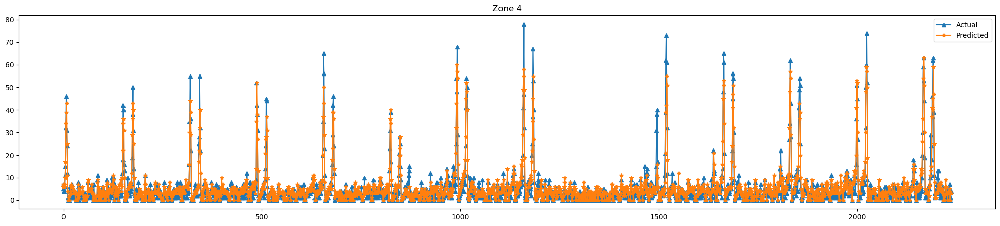

Average RMSE for 2237 days:  2.1363433169423334
full average RMSE =  3.5765465595743136
Average WMAPE for 2237 days:  22.548920872924786
full average WMAPE =  22.54892087292479 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.32 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


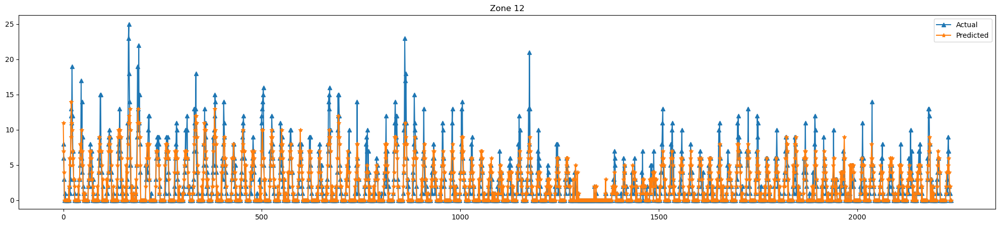

Average RMSE for 2237 days:  0.9611086276262852
full average RMSE =  1.9106084569856876
Average WMAPE for 2237 days:  12.180373590499023
full average WMAPE =  12.180373590499023 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.24 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


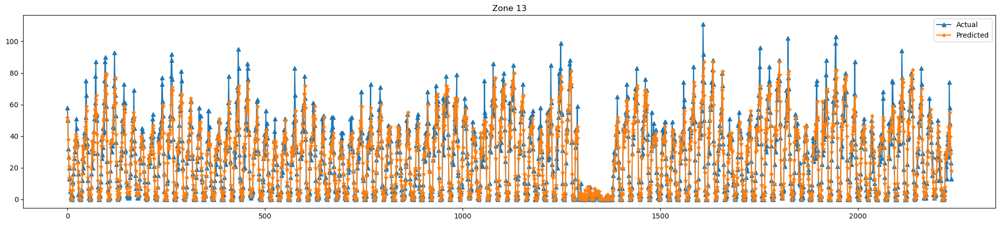

Average RMSE for 2237 days:  5.1032632990612425
full average RMSE =  7.71161018236969
Average WMAPE for 2237 days:  13.258666237103316
full average WMAPE =  13.258666237103316 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.32 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


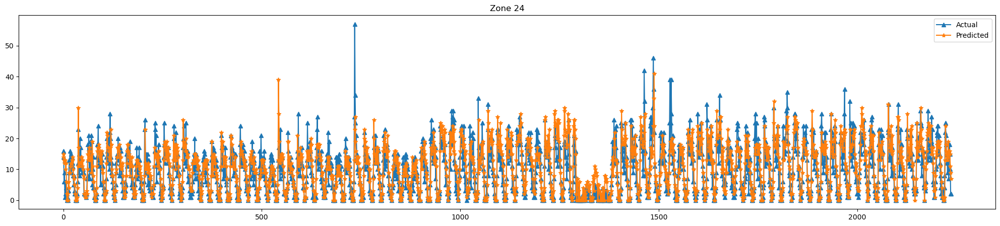

Average RMSE for 2237 days:  3.2641931157800625
full average RMSE =  4.64540572689366
Average WMAPE for 2237 days:  17.984809207420852
full average WMAPE =  17.984809207420852 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.26 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


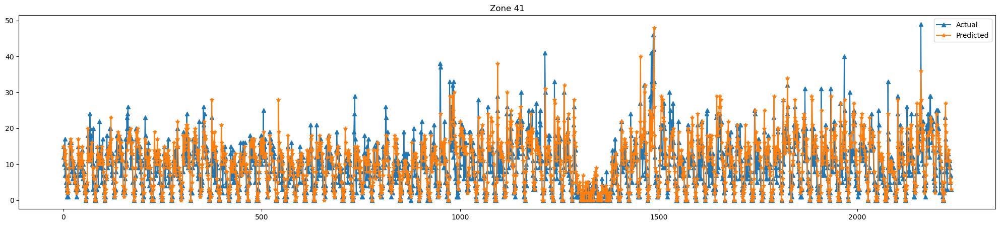

Average RMSE for 2237 days:  3.2847563701385782
full average RMSE =  4.656651022819259
Average WMAPE for 2237 days:  18.23758345741423
full average WMAPE =  18.23758345741423 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.33 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


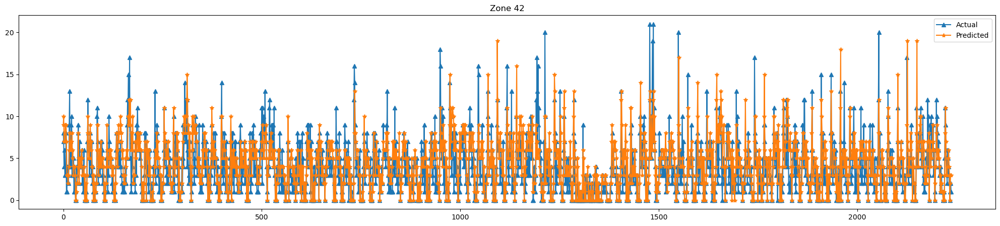

Average RMSE for 2237 days:  1.796155565489495
full average RMSE =  2.5524449873602024
Average WMAPE for 2237 days:  21.732299548936492
full average WMAPE =  21.732299548936492 



Predict: 100%|██████████| 6/6 [00:06<00:00,  1.16s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


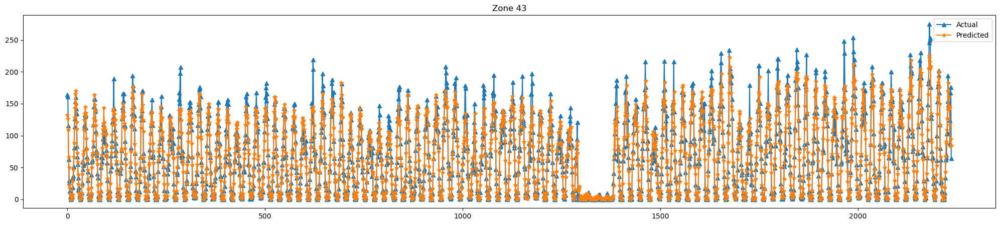

Average RMSE for 2237 days:  11.488600804649083
full average RMSE =  17.61042179348071
Average WMAPE for 2237 days:  12.739401113262808
full average WMAPE =  12.73940111326281 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.29 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


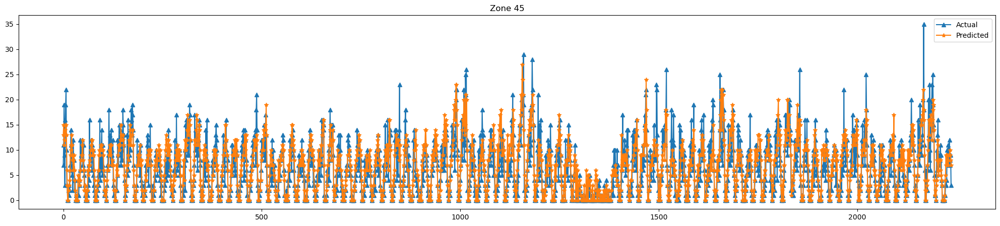

Average RMSE for 2237 days:  2.253017434063478
full average RMSE =  3.279417940657122
Average WMAPE for 2237 days:  17.328143723997197
full average WMAPE =  17.3281437239972 



Predict: 100%|██████████| 6/6 [00:08<00:00,  1.40s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


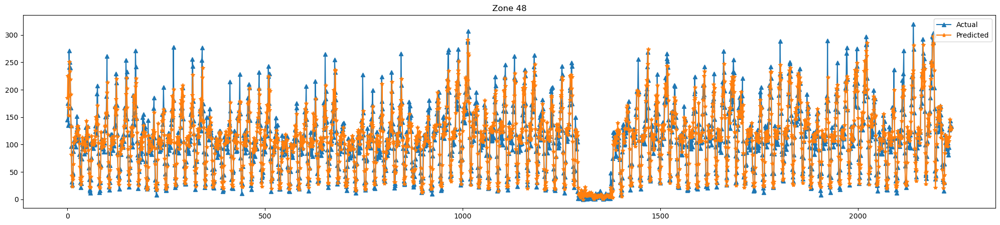

Average RMSE for 2237 days:  15.07107733571748
full average RMSE =  20.776478223820572
Average WMAPE for 2237 days:  8.717234676856515
full average WMAPE =  8.717234676856515 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.33 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


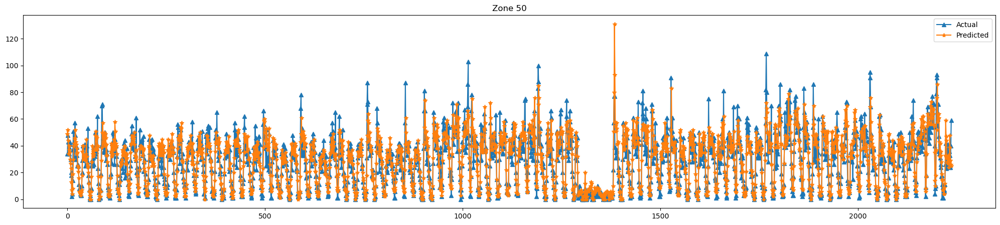

Average RMSE for 2237 days:  6.953956191327671
full average RMSE =  9.929613710056111
Average WMAPE for 2237 days:  15.384665839960995
full average WMAPE =  15.384665839960995 



Predict: 100%|██████████| 6/6 [00:09<00:00,  1.61s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


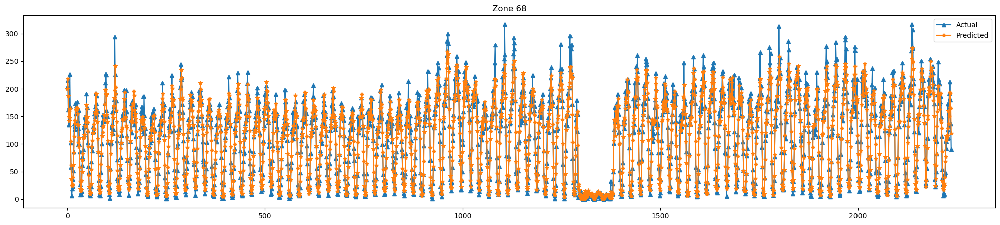

Average RMSE for 2237 days:  13.871703173893607
full average RMSE =  18.941112895266222
Average WMAPE for 2237 days:  9.550044466412075
full average WMAPE =  9.550044466412075 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.31 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


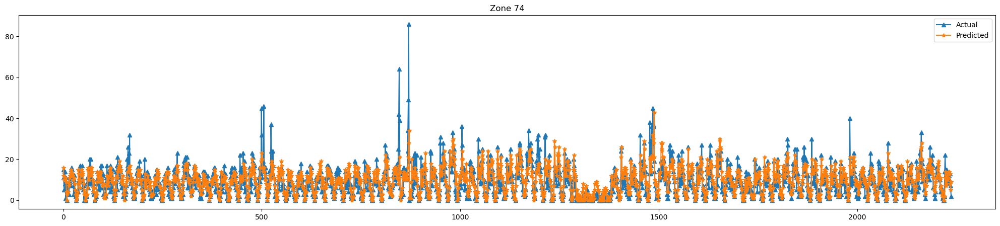

Average RMSE for 2237 days:  3.3191774698256595
full average RMSE =  4.9065017578035635
Average WMAPE for 2237 days:  19.75693645787222
full average WMAPE =  19.756936457872225 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.27 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


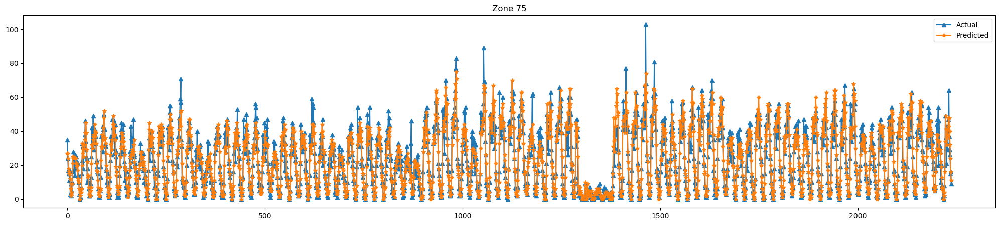

Average RMSE for 2237 days:  4.8940545373267765
full average RMSE =  6.8247098968802895
Average WMAPE for 2237 days:  14.76068919835685
full average WMAPE =  14.760689198356847 



Predict: 100%|██████████| 6/6 [00:07<00:00,  1.23s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


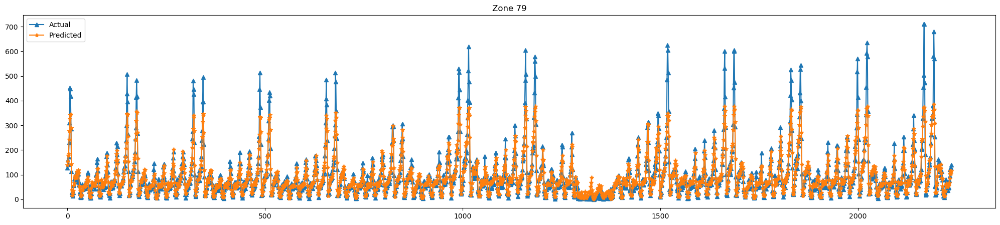

Average RMSE for 2237 days:  17.69244523915959
full average RMSE =  35.37903831730715
Average WMAPE for 2237 days:  11.269069446917326
full average WMAPE =  11.269069446917324 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.26 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


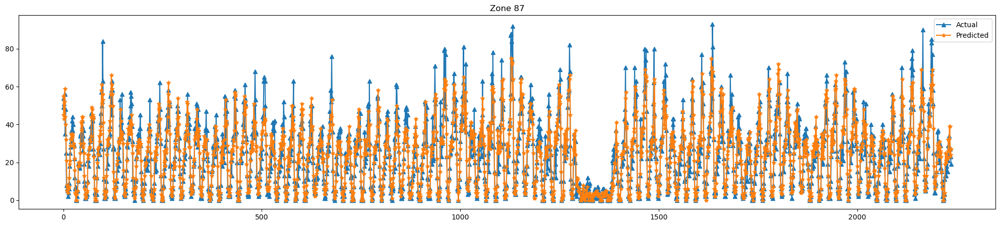

Average RMSE for 2237 days:  5.1636119803308
full average RMSE =  7.428605201159186
Average WMAPE for 2237 days:  14.21807505760722
full average WMAPE =  14.21807505760722 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.31 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


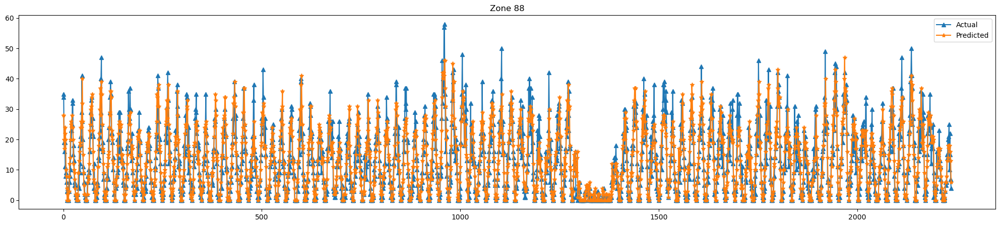

Average RMSE for 2237 days:  3.5243629861421546
full average RMSE =  5.134489861919553
Average WMAPE for 2237 days:  15.077829143728435
full average WMAPE =  15.077829143728433 



Predict: 100%|██████████| 6/6 [00:06<00:00,  1.04s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


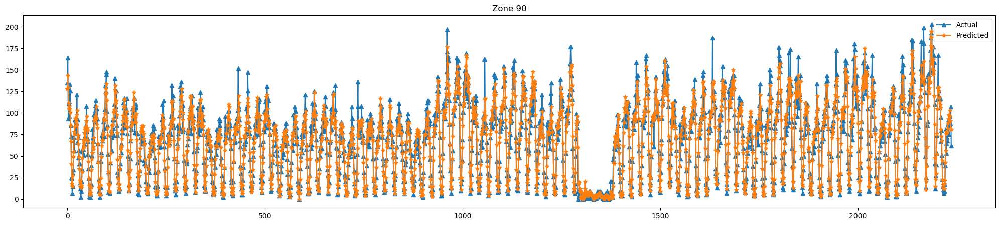

Average RMSE for 2237 days:  9.398748323647743
full average RMSE =  13.038833371192247
Average WMAPE for 2237 days:  9.751149446820133
full average WMAPE =  9.751149446820133 



Predict: 100%|██████████| 6/6 [00:05<00:00,  1.03 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


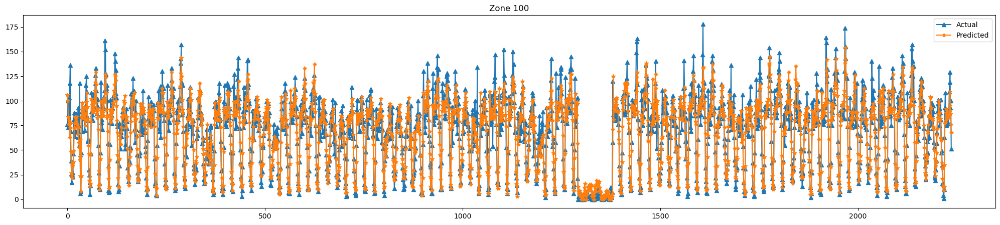

Average RMSE for 2237 days:  10.63969602145731
full average RMSE =  14.307982835492293
Average WMAPE for 2237 days:  10.735795656430644
full average WMAPE =  10.735795656430644 



Predict: 100%|██████████| 6/6 [00:06<00:00,  1.15s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


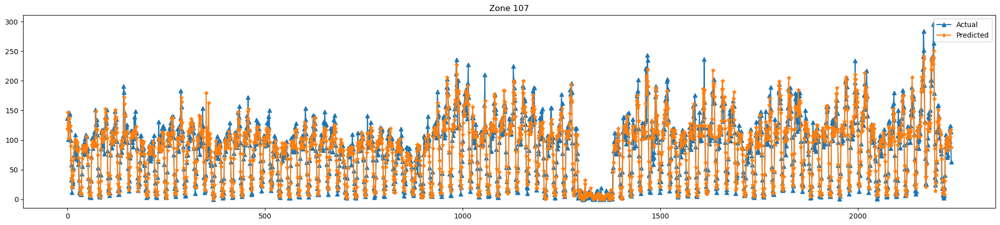

Average RMSE for 2237 days:  11.487706750111757
full average RMSE =  15.731287356014908
Average WMAPE for 2237 days:  9.799833775187503
full average WMAPE =  9.799833775187503 



Predict: 100%|██████████| 6/6 [00:05<00:00,  1.04 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


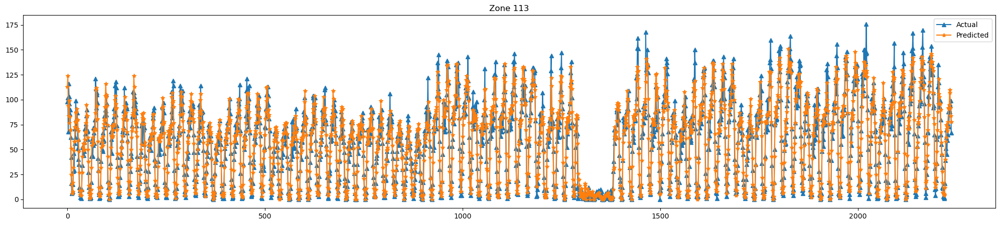

Average RMSE for 2237 days:  8.81001341081806
full average RMSE =  12.146880848579002
Average WMAPE for 2237 days:  12.000445098429827
full average WMAPE =  12.000445098429825 



Predict: 100%|██████████| 6/6 [00:06<00:00,  1.06s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


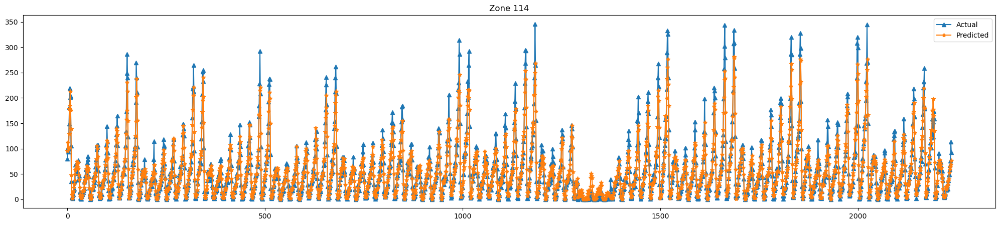

Average RMSE for 2237 days:  9.967367009387573
full average RMSE =  15.597430527820384
Average WMAPE for 2237 days:  13.725919343893828
full average WMAPE =  13.725919343893828 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.32 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


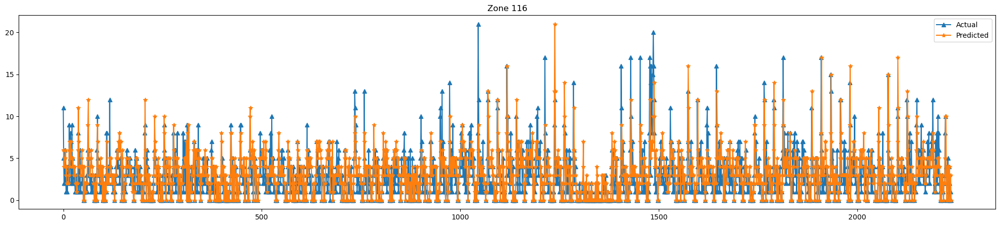

Average RMSE for 2237 days:  1.5055878408582923
full average RMSE =  2.2706854728833585
Average WMAPE for 2237 days:  21.953542972992153
full average WMAPE =  21.953542972992153 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.32 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


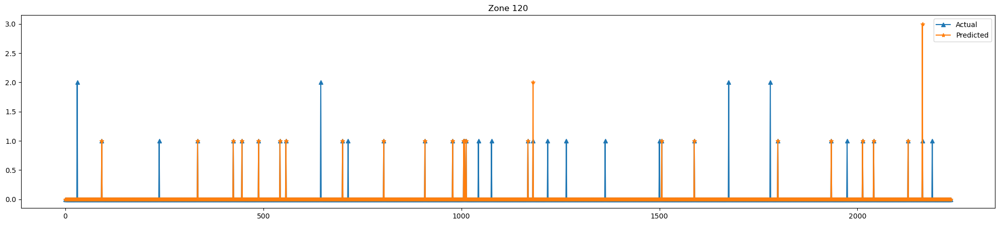

Average RMSE for 2237 days:  0.009387572641931158
full average RMSE =  0.11771934984769938
Average WMAPE for 2237 days:  0.6630904430474843
full average WMAPE =  0.6630904430474843 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.30 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


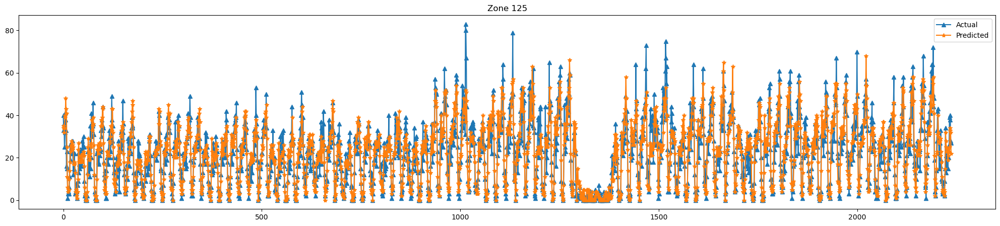

Average RMSE for 2237 days:  4.980330800178811
full average RMSE =  6.889607860283818
Average WMAPE for 2237 days:  14.760096277892302
full average WMAPE =  14.760096277892304 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.33 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


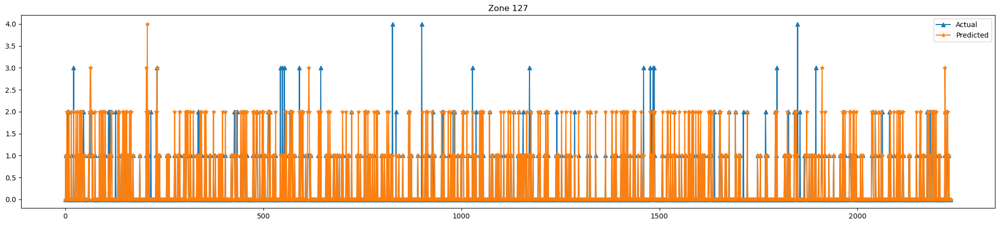

Average RMSE for 2237 days:  0.1318730442556996
full average RMSE =  0.4061441396066061
Average WMAPE for 2237 days:  4.324243764062981
full average WMAPE =  4.324243764062981 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.29 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


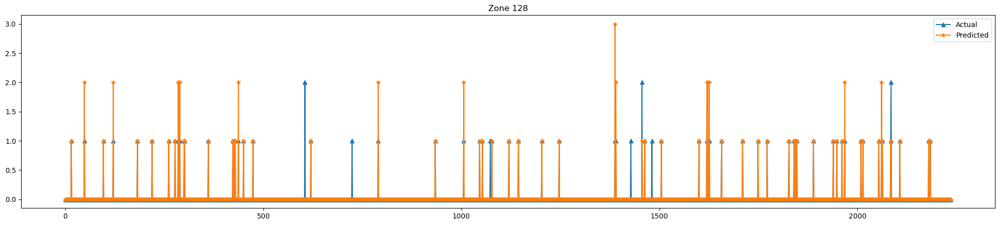

Average RMSE for 2237 days:  0.010728654447921324
full average RMSE =  0.11580508650271651
Average WMAPE for 2237 days:  0.4991804470210599
full average WMAPE =  0.49918044702105996 



Predict: 100%|██████████| 6/6 [00:05<00:00,  1.14 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


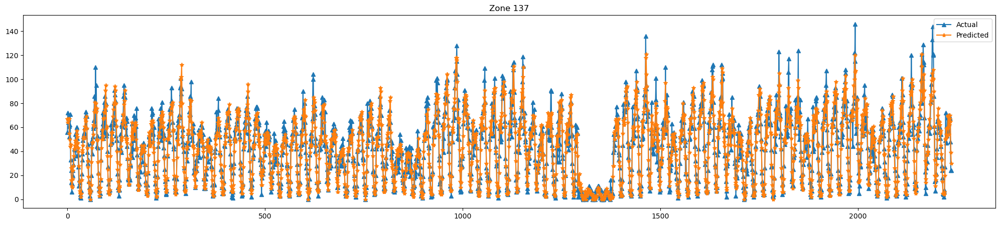

Average RMSE for 2237 days:  7.065265981224854
full average RMSE =  9.592665019302641
Average WMAPE for 2237 days:  11.15555764519327
full average WMAPE =  11.155557645193268 



Predict: 100%|██████████| 6/6 [00:07<00:00,  1.25s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


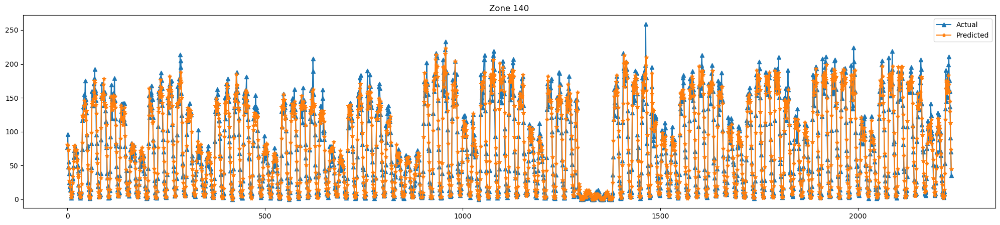

Average RMSE for 2237 days:  9.844881537773805
full average RMSE =  14.054288381285485
Average WMAPE for 2237 days:  10.55663900846162
full average WMAPE =  10.55663900846162 



Predict: 100%|██████████| 6/6 [00:07<00:00,  1.27s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


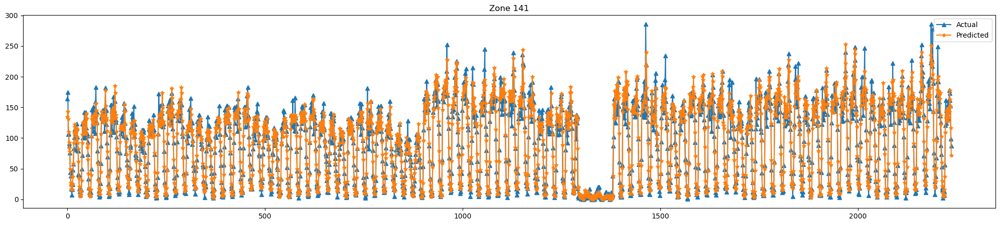

Average RMSE for 2237 days:  11.144389807778275
full average RMSE =  15.416001648920423
Average WMAPE for 2237 days:  9.229490373835649
full average WMAPE =  9.22949037383565 



Predict: 100%|██████████| 6/6 [00:10<00:00,  1.71s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


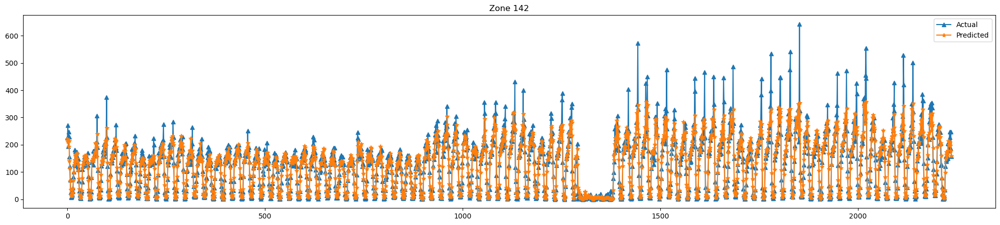

Average RMSE for 2237 days:  18.529280286097453
full average RMSE =  32.917243600284955
Average WMAPE for 2237 days:  11.541182815495675
full average WMAPE =  11.541182815495677 



Predict: 100%|██████████| 6/6 [00:05<00:00,  1.18 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


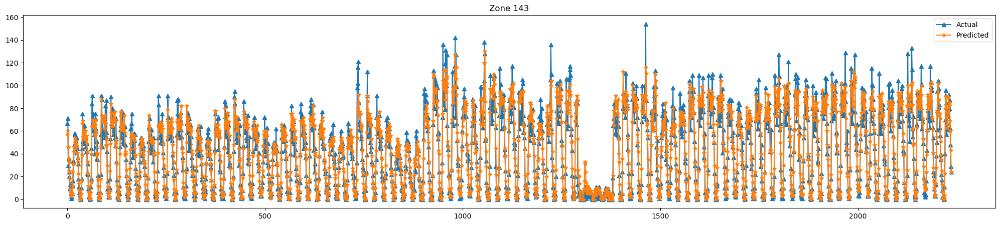

Average RMSE for 2237 days:  7.285203397407241
full average RMSE =  10.415871970878085
Average WMAPE for 2237 days:  12.80739203055414
full average WMAPE =  12.80739203055414 



Predict: 100%|██████████| 6/6 [00:05<00:00,  1.18 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


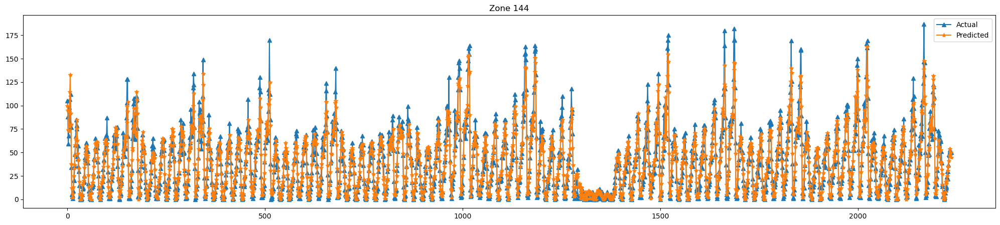

Average RMSE for 2237 days:  6.8511399195350915
full average RMSE =  9.874039056813833
Average WMAPE for 2237 days:  14.665103972290959
full average WMAPE =  14.66510397229096 



Predict: 100%|██████████| 6/6 [00:05<00:00,  1.05 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


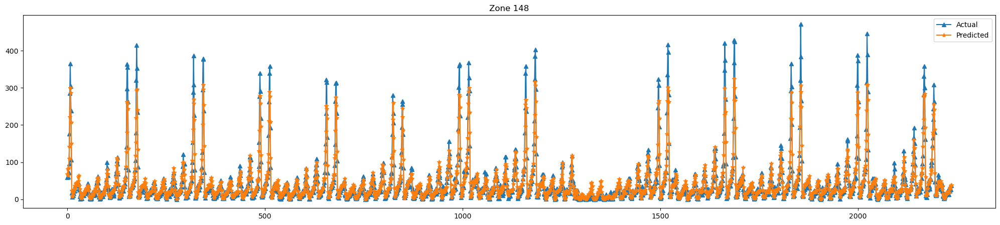

Average RMSE for 2237 days:  9.796155565489494
full average RMSE =  18.54456146546358
Average WMAPE for 2237 days:  14.838820369014025
full average WMAPE =  14.83882036901402 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.24 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


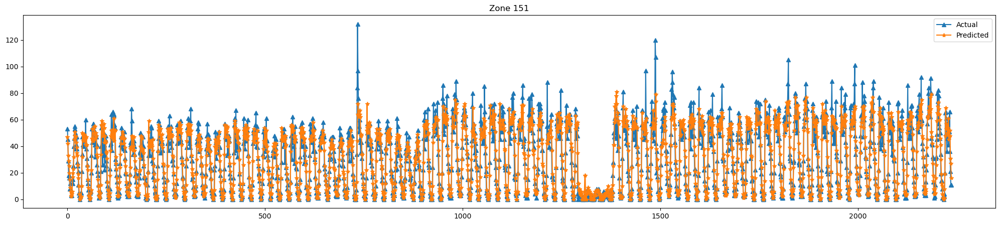

Average RMSE for 2237 days:  6.053196244970943
full average RMSE =  8.772162048232296
Average WMAPE for 2237 days:  13.662684293454047
full average WMAPE =  13.662684293454047 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.35 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


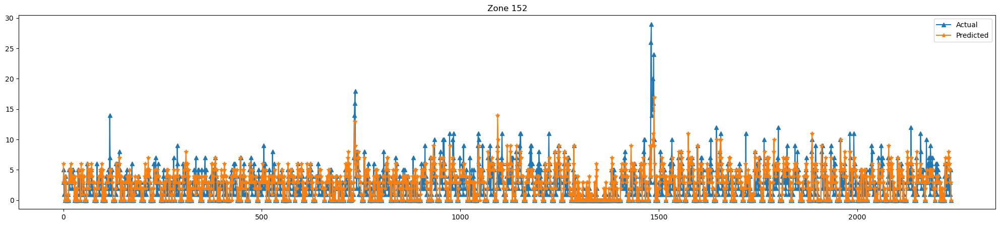

Average RMSE for 2237 days:  1.3178363880196693
full average RMSE =  2.075034132674872
Average WMAPE for 2237 days:  19.728038565533815
full average WMAPE =  19.72803856553381 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.29 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


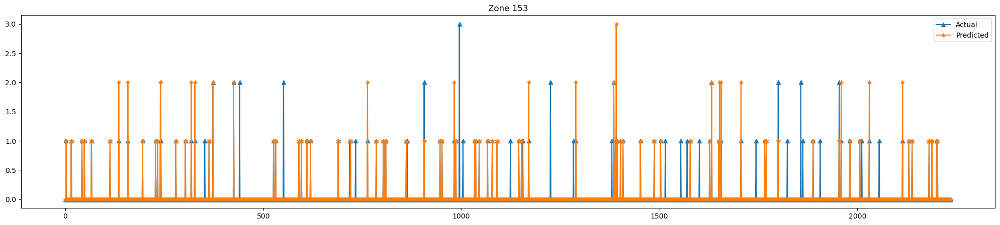

Average RMSE for 2237 days:  0.0232454179704962
full average RMSE =  0.174349804327709
Average WMAPE for 2237 days:  1.4230367942619082
full average WMAPE =  1.4230367942619084 



Predict: 100%|██████████| 6/6 [00:05<00:00,  1.16 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


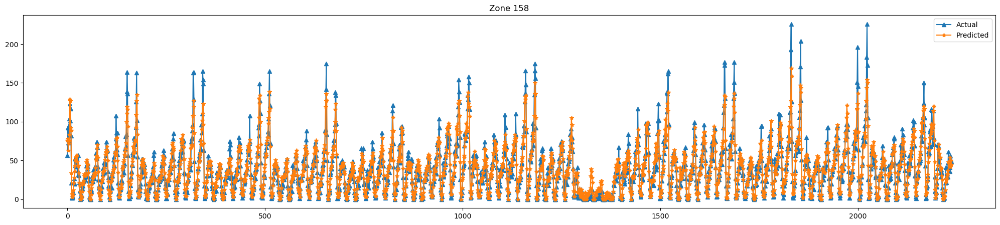

Average RMSE for 2237 days:  7.302190433616451
full average RMSE =  10.81826548606364
Average WMAPE for 2237 days:  13.164128484334665
full average WMAPE =  13.164128484334665 



Predict: 100%|██████████| 6/6 [00:11<00:00,  1.93s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


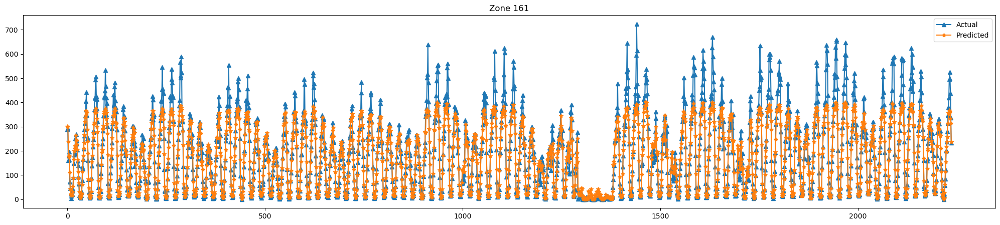

Average RMSE for 2237 days:  31.248547161376845
full average RMSE =  53.777597109084375
Average WMAPE for 2237 days:  11.638168770667733
full average WMAPE =  11.638168770667736 



Predict: 100%|██████████| 6/6 [00:11<00:00,  1.95s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


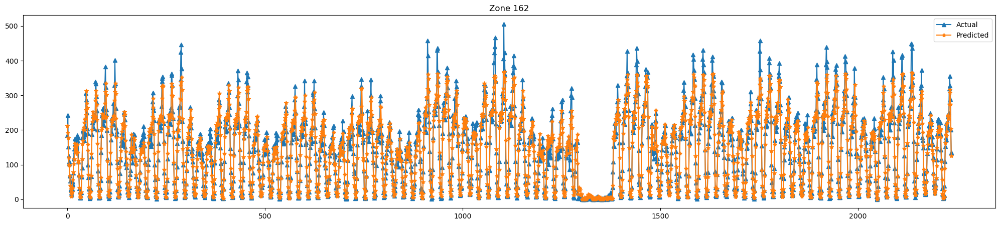

Average RMSE for 2237 days:  18.443004023245418
full average RMSE =  26.668774130700715
Average WMAPE for 2237 days:  9.616359328612418
full average WMAPE =  9.616359328612418 



Predict: 100%|██████████| 6/6 [00:09<00:00,  1.65s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


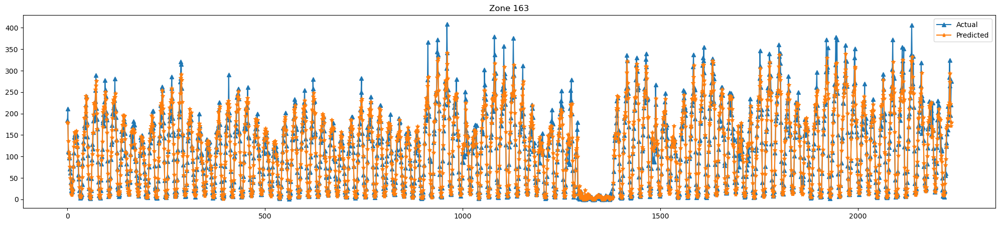

Average RMSE for 2237 days:  14.789003129190881
full average RMSE =  21.85088858928306
Average WMAPE for 2237 days:  9.873889755719473
full average WMAPE =  9.873889755719475 



Predict: 100%|██████████| 6/6 [00:08<00:00,  1.41s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


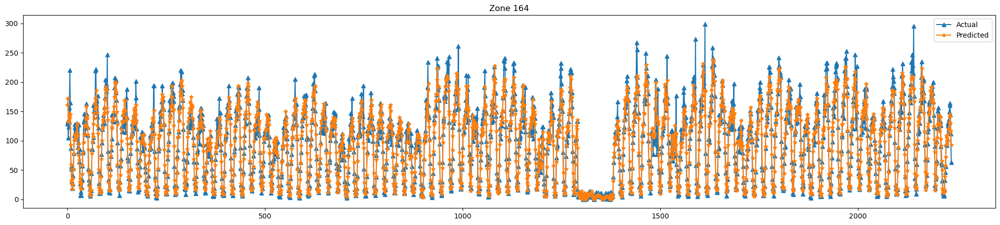

Average RMSE for 2237 days:  12.517657577112203
full average RMSE =  18.48760896635373
Average WMAPE for 2237 days:  8.871166686373291
full average WMAPE =  8.871166686373293 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.32 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


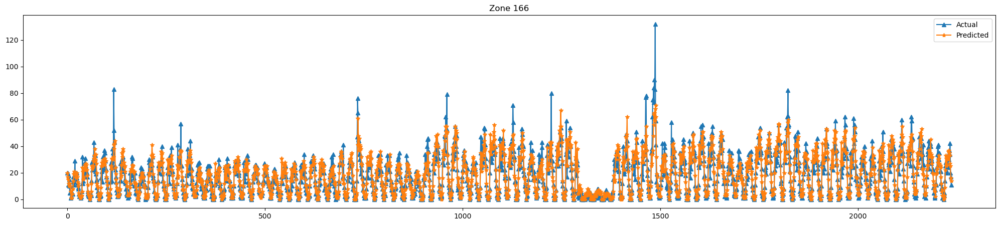

Average RMSE for 2237 days:  4.485024586499777
full average RMSE =  6.639615060662582
Average WMAPE for 2237 days:  15.944465058680887
full average WMAPE =  15.94446505868089 



Predict: 100%|██████████| 6/6 [00:10<00:00,  1.70s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


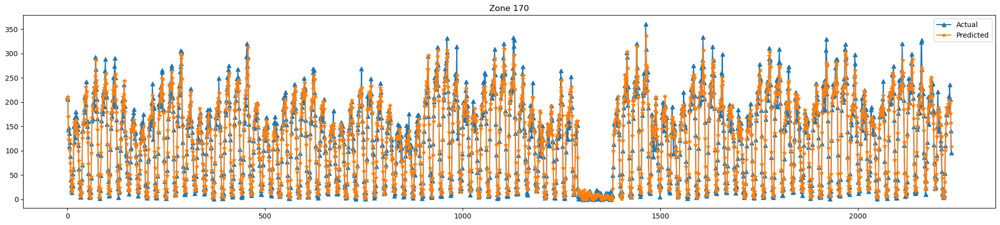

Average RMSE for 2237 days:  14.071524362986143
full average RMSE =  19.323447392553096
Average WMAPE for 2237 days:  9.6320804499991
full average WMAPE =  9.632080449999098 



Predict: 100%|██████████| 6/6 [00:11<00:00,  1.94s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


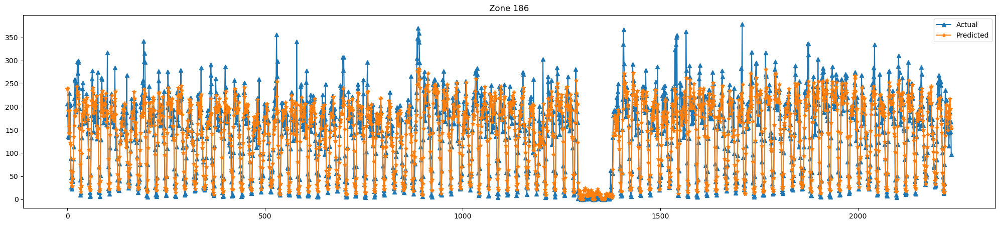

Average RMSE for 2237 days:  24.776933392936968
full average RMSE =  34.75623008508422
Average WMAPE for 2237 days:  12.668159605645114
full average WMAPE =  12.668159605645112 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.25 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


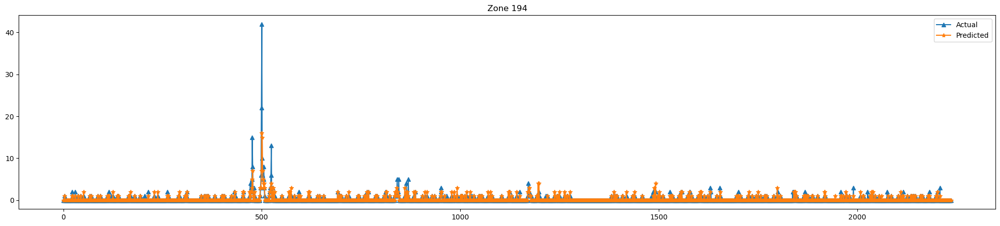

Average RMSE for 2237 days:  0.11041573535985695
full average RMSE =  0.7986913749269209
Average WMAPE for 2237 days:  2.8500011246110657
full average WMAPE =  2.8500011246110657 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.32 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


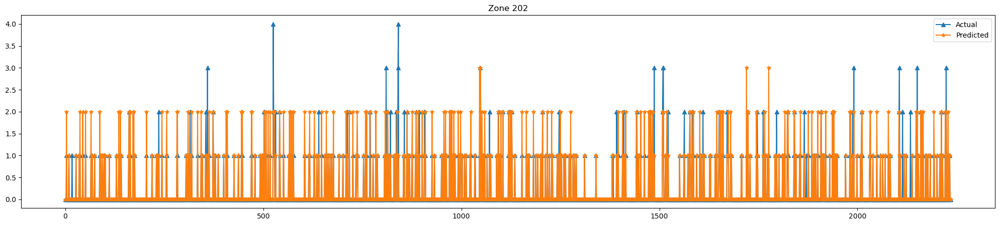

Average RMSE for 2237 days:  0.0889584264640143
full average RMSE =  0.3227341841184003
Average WMAPE for 2237 days:  3.0502160515002728
full average WMAPE =  3.0502160515002728 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.32 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


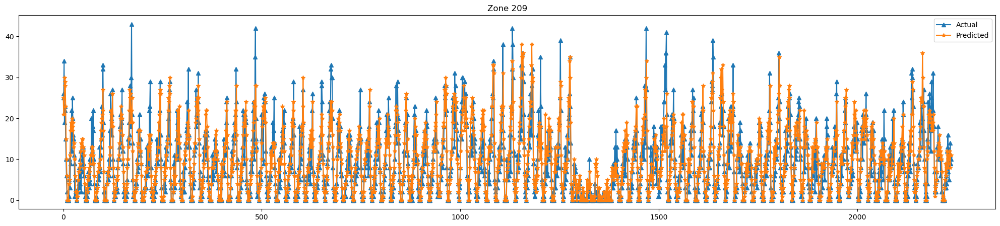

Average RMSE for 2237 days:  3.0044702726866337
full average RMSE =  4.418688721036006
Average WMAPE for 2237 days:  17.235670222173077
full average WMAPE =  17.235670222173077 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.24 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


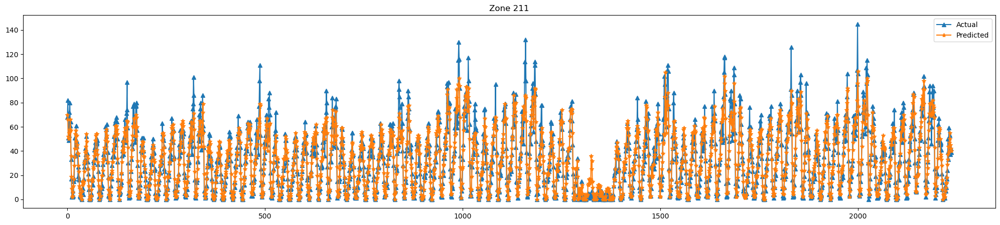

Average RMSE for 2237 days:  6.067054090299508
full average RMSE =  8.758672820429137
Average WMAPE for 2237 days:  13.56165237227415
full average WMAPE =  13.56165237227415 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.28 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


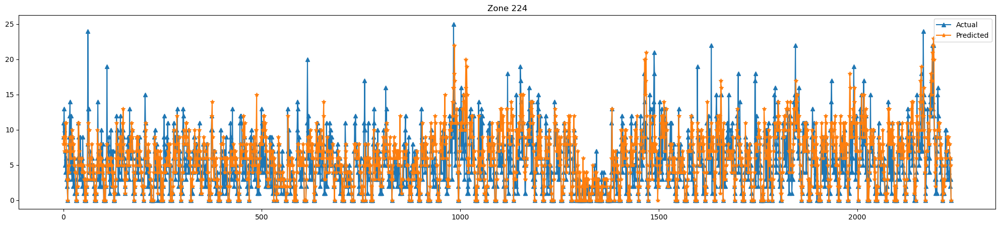

Average RMSE for 2237 days:  2.3366115333035316
full average RMSE =  3.2445408226364076
Average WMAPE for 2237 days:  20.796420031843454
full average WMAPE =  20.796420031843454 



Predict: 100%|██████████| 6/6 [00:06<00:00,  1.13s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


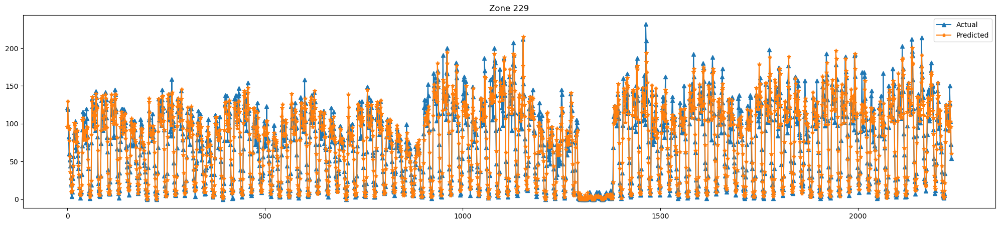

Average RMSE for 2237 days:  10.198033080017881
full average RMSE =  14.402276554759236
Average WMAPE for 2237 days:  9.808259285627635
full average WMAPE =  9.808259285627637 



Predict: 100%|██████████| 6/6 [00:11<00:00,  1.87s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


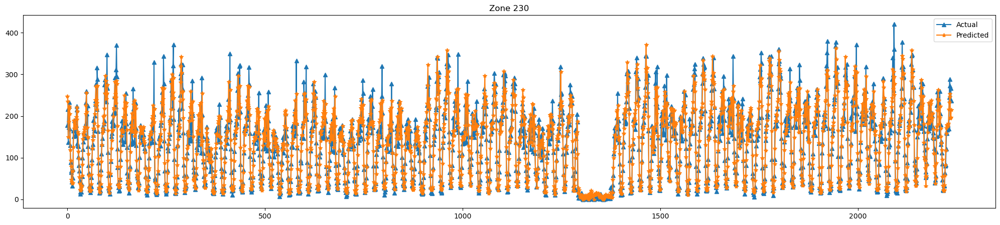

Average RMSE for 2237 days:  19.308001788109074
full average RMSE =  27.53279022051301
Average WMAPE for 2237 days:  9.170513136200752
full average WMAPE =  9.170513136200752 



Predict: 100%|██████████| 6/6 [00:05<00:00,  1.04 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


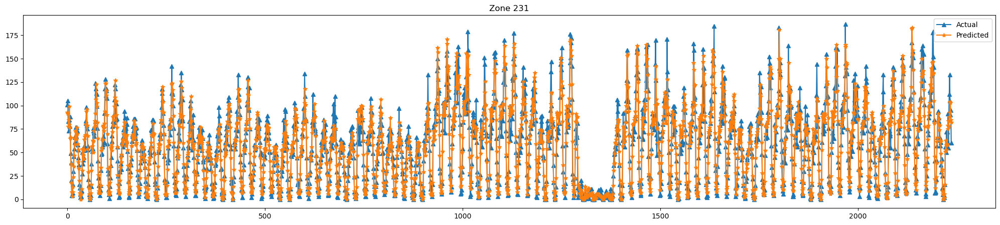

Average RMSE for 2237 days:  8.670987930263745
full average RMSE =  12.017365619871226
Average WMAPE for 2237 days:  11.540963349723782
full average WMAPE =  11.54096334972378 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.24 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


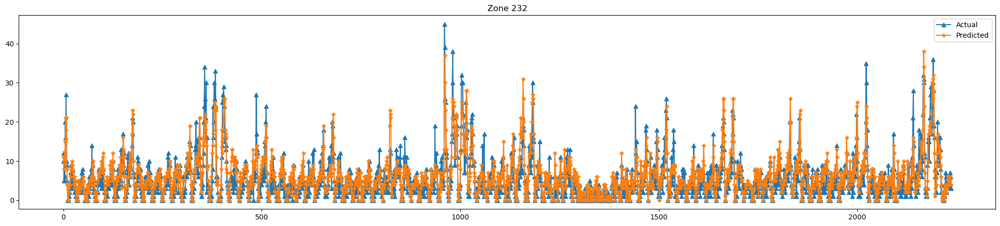

Average RMSE for 2237 days:  2.331247206079571
full average RMSE =  3.4294081721581477
Average WMAPE for 2237 days:  21.147475545107184
full average WMAPE =  21.147475545107184 



Predict: 100%|██████████| 6/6 [00:05<00:00,  1.13 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


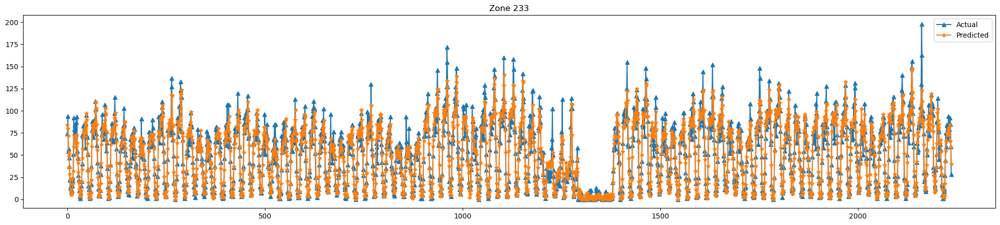

Average RMSE for 2237 days:  8.305766651765758
full average RMSE =  11.506620900238135
Average WMAPE for 2237 days:  12.145337044721805
full average WMAPE =  12.145337044721805 



Predict: 100%|██████████| 6/6 [00:09<00:00,  1.63s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


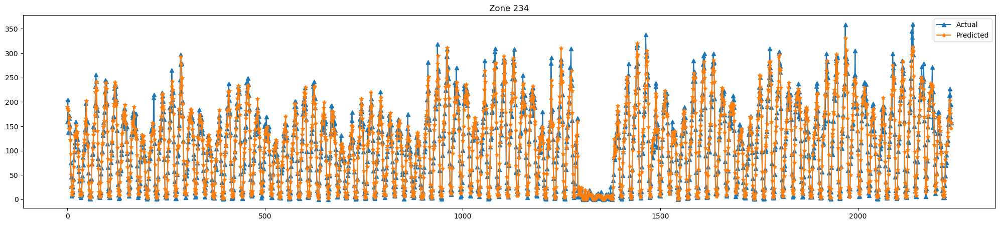

Average RMSE for 2237 days:  12.096557890031292
full average RMSE =  17.20782015984459
Average WMAPE for 2237 days:  9.707331873567282
full average WMAPE =  9.707331873567284 



Predict: 100%|██████████| 6/6 [00:11<00:00,  1.88s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


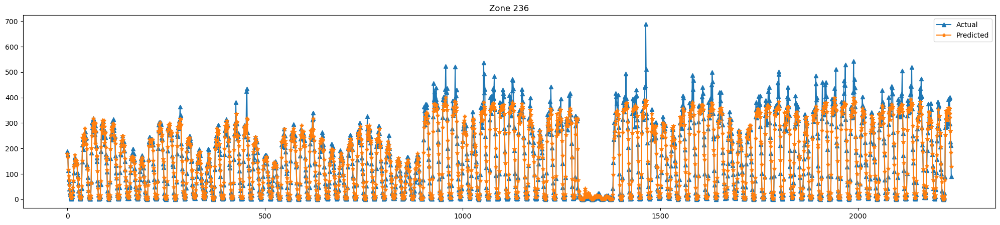

Average RMSE for 2237 days:  18.843093428699152
full average RMSE =  29.583458993900777
Average WMAPE for 2237 days:  11.428323194822644
full average WMAPE =  11.42832319482264 



Predict: 100%|██████████| 6/6 [00:11<00:00,  1.93s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


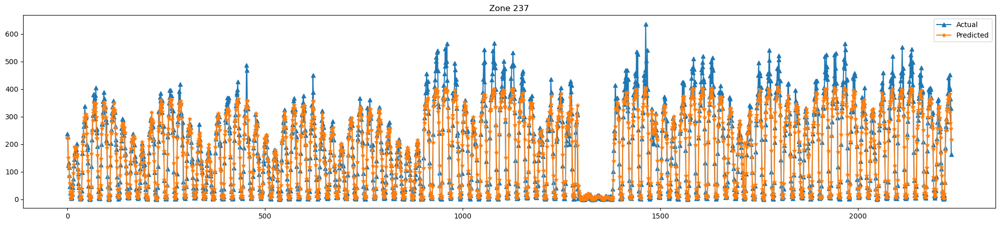

Average RMSE for 2237 days:  22.975860527492177
full average RMSE =  37.23428585208286
Average WMAPE for 2237 days:  10.552509729559628
full average WMAPE =  10.552509729559628 



Predict: 100%|██████████| 6/6 [00:06<00:00,  1.17s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


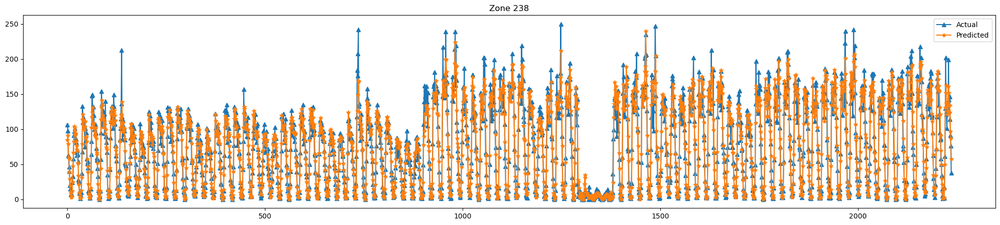

Average RMSE for 2237 days:  10.289673670093876
full average RMSE =  14.910941100615846
Average WMAPE for 2237 days:  11.158224831105398
full average WMAPE =  11.1582248311054 



Predict: 100%|██████████| 6/6 [00:10<00:00,  1.67s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


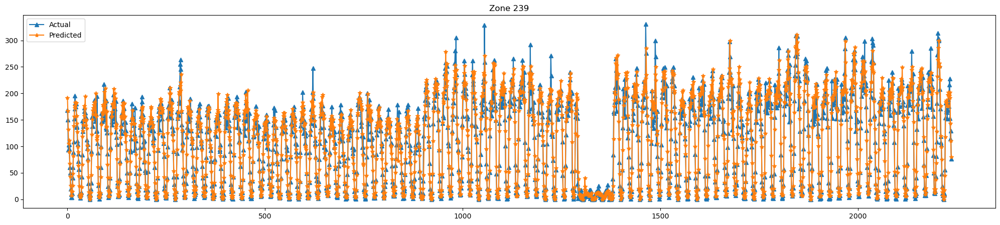

Average RMSE for 2237 days:  14.448368350469378
full average RMSE =  20.814537490495137
Average WMAPE for 2237 days:  10.306013984021074
full average WMAPE =  10.306013984021074 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.27 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


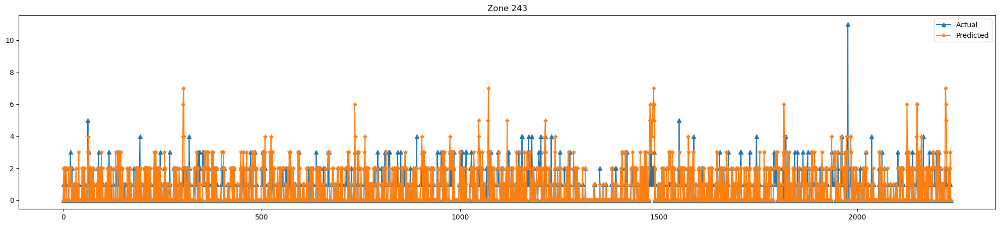

Average RMSE for 2237 days:  0.4072418417523469
full average RMSE =  0.8755865267109306
Average WMAPE for 2237 days:  11.02174110188828
full average WMAPE =  11.021741101888281 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.32 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


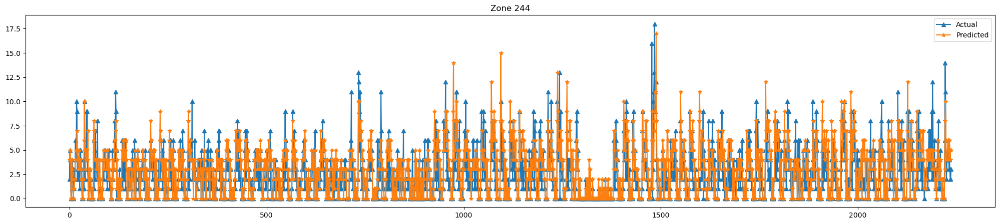

Average RMSE for 2237 days:  1.3442109968708091
full average RMSE =  2.037094532662202
Average WMAPE for 2237 days:  20.00023500617681
full average WMAPE =  20.000235006176805 



Predict: 100%|██████████| 6/6 [00:07<00:00,  1.21s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


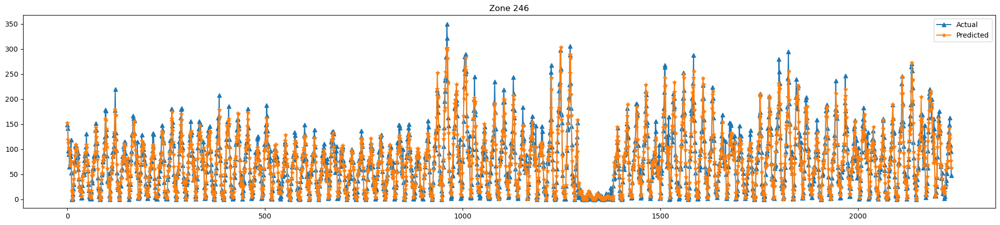

Average RMSE for 2237 days:  11.481895395619134
full average RMSE =  15.995571023124922
Average WMAPE for 2237 days:  12.574908839859752
full average WMAPE =  12.574908839859752 



Predict: 100%|██████████| 6/6 [00:08<00:00,  1.38s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


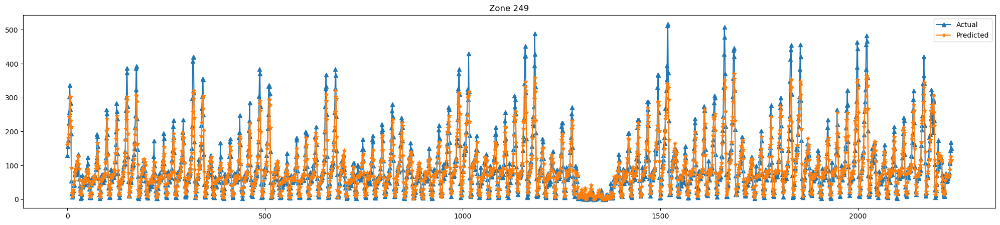

Average RMSE for 2237 days:  15.744300402324543
full average RMSE =  25.3475263945568
Average WMAPE for 2237 days:  11.335224034209494
full average WMAPE =  11.335224034209494 



Predict: 100%|██████████| 6/6 [00:04<00:00,  1.27 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


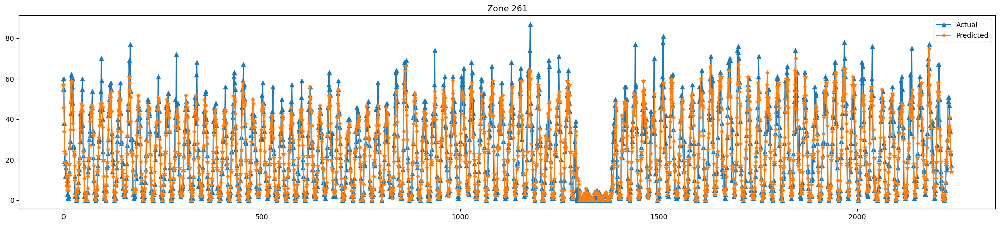

Average RMSE for 2237 days:  4.8994188645507375
full average RMSE =  7.088747087493776
Average WMAPE for 2237 days:  14.443808805807993
full average WMAPE =  14.443808805807995 



Predict: 100%|██████████| 6/6 [00:05<00:00,  1.05 batches/s]


pred_start_idx =  2021-04-24 04:00:00 22551


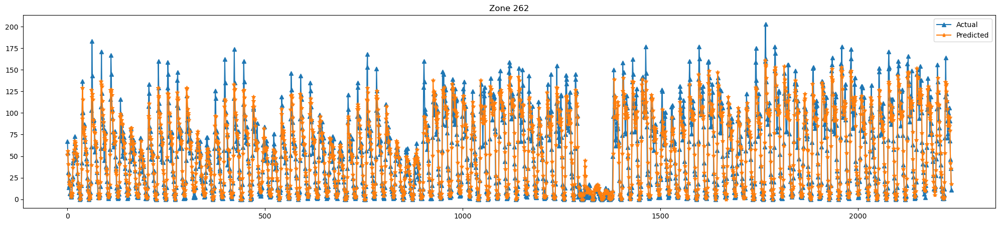

Average RMSE for 2237 days:  9.13455520786768
full average RMSE =  13.275290890757999
Average WMAPE for 2237 days:  13.246682700545728
full average WMAPE =  13.246682700545728 



Predict: 100%|██████████| 6/6 [00:06<00:00,  1.04s/ batches]


pred_start_idx =  2021-04-24 04:00:00 22551


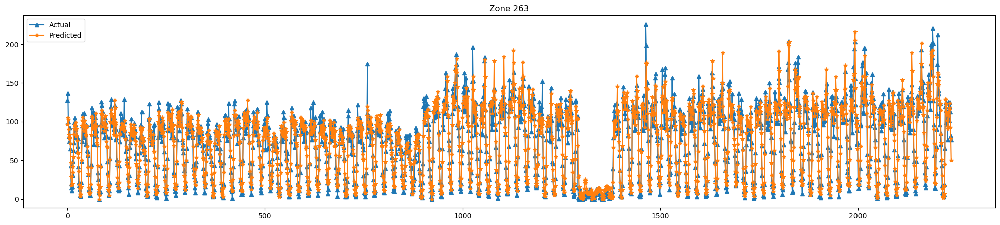

Average RMSE for 2237 days:  9.842646401430487
full average RMSE =  13.431493092929356
Average WMAPE for 2237 days:  10.502509390565951
full average WMAPE =  10.502509390565951 



'\nMachine Learning predictions END\n'

In [ ]:
"""
Machine Learning predictions START
1) DeepAR

"""
trainer = pl.Trainer(
    max_epochs=num_ep,
    accelerator='gpu',
    devices=[0],
    auto_lr_find=False,
    gradient_clip_val=0.1,
    limit_train_batches=1.0,
    limit_val_batches=1.0,
    #fast_dev_run=fdv_steps,
    logger=True,
    #log_every_n_steps=10,
    # profiler=True,
    callbacks=[lr_logger]#, early_stop_callback],
    #enable_checkpointing=True,
    #default_root_dir="C:\Work\WORK_PACKAGE\Demand_forecasting\github\DeepAR-pytorch\My_model\2_freq_nbinom_LSTM\1_cluster_demand_prediction\logs"
)

#print(f"training routing:\n \n {trainer}")
deepar =DeepAR.from_dataset(
    train_dataset,
    learning_rate=lr,
    hidden_size=neu,
    rnn_layers=lay,
    dropout=drop,
    loss=Loss,
    log_interval=20,
    log_val_interval=6,
    log_gradient_flow=False,
    embedding_sizes=embed_size_dict
    # reduce_on_plateau_patience=3,
)

#print(f"Number of parameters in network: {deepar.size()/1e3:.1f}k")
# print(f"Model :\n \n {deepar}")
torch.set_num_threads(10)
trainer.fit(
    deepar,
    train_dataloaders=train_dataloader,
    val_dataloaders=val_dataloader,
)

########## Prediction #####################

for group in unique_values_group_no_ts_fresh:
  test_dataset = TimeSeriesDataSet.from_dataset(train_dataset,df[df['time_idx'].isin(test_time_idx) & (df['group'] == group)], stop_randomization=True)
  test_dataloader = test_dataset.to_dataloader(train=False, batch_size=bat)


  test_output = deepar.predict(data=test_dataloader,mode='prediction',return_index=True,num_workers=8,show_progress_bar=True)

  pred_start_idx = int(test_output[1]['time_idx'][0])

  actual1_full = np.array([])
  pred_full = np.array([])
  RMSE_list = np.array([])
  WMAPE_list = np.array([])
  days = tes_stop_idx - val_stop_idx - pred_len - pred_len

  for j in range(0,days,pred_len):

    if j == 0:
      print('pred_start_idx = ',df["datetime"].iloc[pred_start_idx],pred_start_idx )

    actual_df = df[df['group'] == group]

    prediction_index = [*range(pred_start_idx+(j), pred_start_idx+(j)+pred_len, 1)]

    actual = actual_df[actual_df['time_idx'].isin(prediction_index)]['target'].values

    actual1_full = np.append(actual1_full, actual)
    #plt.plot(actual,'*-')
    pred = np.array(np.rint(test_output[0][j])).astype(int)

    pred_full = np.append(pred_full, pred)
    #plt.plot(pred,'^-')
    #plt.show()

    absolute_error = np.abs(actual - pred)
    absolute_sum = np.abs(actual) + np.abs(pred)
    WMAPE = np.mean(absolute_error / (absolute_sum + 1e-8)) * 100

    # WMAPE = np.mean(np.abs(actual-pred)/np.abs(actual)+ 1e-8) * 100
    RMSE = np.sqrt(mean_squared_error(actual,pred ))
    #print('RMSE : ',RMSE)
    RMSE_list = np.append(RMSE_list,RMSE)
    WMAPE_list = np.append(WMAPE_list,WMAPE)

  plt.figure(figsize=(25,5))
  plt.plot(actual1_full.flatten(),'^-', label='Actual')
  plt.plot(pred_full.flatten(),'*-', label='Predicted')
  plt.title('Zone ' + str(group))  # Replace 'XYZ' with your actual group number
  plt.legend()
  plt.show()

  print(f'Average RMSE for {days} days: ',np.mean(RMSE_list))
  print('full average RMSE = ',np.sqrt(mean_squared_error(actual1_full.flatten(),pred_full.flatten() )))
  print(f'Average WMAPE for {days} days: ',np.mean(WMAPE_list))
  wmape_full = np.mean(np.abs(actual1_full.flatten() - pred_full.flatten()) / (np.abs(actual1_full.flatten()) + np.abs(pred_full.flatten()) + 1e-8)) * 100
  print('full average WMAPE = ', wmape_full, '\n')

########## Prediction #####################



"""
Machine Learning predictions END
"""